# SegNet with PyTorch
**References**  
1. https://arxiv.org/abs/1511.00561
2. http://blog.qure.ai/notes/semantic-segmentation-deep-learning-review
3. https://arxiv.org/abs/1409.1556

**Summary:**  

This core trainable segmentation engine consists of an encoder network, a corresponding decoder network followed by a pixel-wise classification layer. The architecture of the encoder network is topologically identical to the 13 convolutional layers in the VGG16 network 

In [1]:
%matplotlib inline
import os
import numpy as np
import matplotlib.pyplot as plt
import pylab
import random
from random import shuffle
from cv2 import resize, imread, imwrite, cvtColor, INTER_NEAREST, INTER_CUBIC, IMREAD_COLOR, COLOR_BGR2RGB

# COCO dataset API
from pycocotools.coco import COCO

# PyTorch
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms, utils

# Ignore warnings
import warnings
warnings.filterwarnings("ignore")

# interactive mode
plt.ion()   

# Image augmentation
import imgaug as ia
from imgaug import augmenters as iaa

# set seed
torch.manual_seed(1)

# define data set location
dataDir='/home/jeff/Documents/data_sets/coco' # modify this path appropriatly to your downloaded coco dataset
dataType=['train2017','val2017']
train_annFile='{}/annotations/instances_{}.json'.format(dataDir,dataType[0])
test_annFile='{}/annotations/instances_{}.json'.format(dataDir,dataType[1])

# initialize COCO api for instance annotations
coco_train=COCO(train_annFile)
coco_test=COCO(test_annFile)

loading annotations into memory...
Done (t=16.47s)
creating index...
index created!
loading annotations into memory...
Done (t=0.52s)
creating index...
index created!


In [2]:
# # load and display image
# # I = io.imread('%s/images/%s/%s'%(dataDir,dataType[0],img['file_name']))
# # use url to load image
# img = coco_train.loadImgs([204821])[0]
# I = Image.open(os.path.join(dataDir, 'images', dataType[0], img['file_name']))

# img = np.array(I)
# plt.imshow(I); plt.axis('off')

# # load and display instance annotations
# categories = ['zebra', 'cake']
# gt = np.zeros((img.shape[0],img.shape[1]))

# catIds = coco_train.getCatIds(catNms=categories);
# annIds = coco_train.getAnnIds(imgIds=[204821], catIds=catIds, iscrowd=False)

# anns = coco_train.loadAnns(annIds)

# for ann in anns:
#     mask = coco_train.annToMask(ann)
#     gt[mask == 1] = ann['category_id']

# plt.imshow(I)
# plt.show()
# plt.imshow(gt)
# plt.show()

# # print np.asarray(I)

# data_transform = transforms.Compose([
#                                 transforms.ToTensor(),
#                                 transforms.Normalize(mean = [i/255. for i in [125, 125, 125]], std = [i/255. for i in [25, 25, 25]])
#                                     ])

# tensor_to_PIL = transforms.ToPILImage(mode=None)

# I = data_transform(I)
# I = I.cpu()
# I = tensor_to_PIL(I)

# plt.imshow(I)
# plt.show()

# print np.unique(I)

In [56]:
class COCO_dataset(Dataset):
    'Characterizes a dataset for PyTorch'
    def __init__(self, list_IDs, data_split, object_classes, coco_API, im_width, im_height, transform = None, data_dir='/home/jeff/Documents/data_sets/coco', cache_dir = '/home/jeff/Documents/data_sets/coco_cache'):
        'Initialization'
        self.list_IDs = list_IDs
        self.data_split = data_split
        self.data_dir = data_dir
        self.coco_API = coco_API
        self.cache_dir = cache_dir
        
        self.im_width = im_width
        self.im_height = im_height
        
        # make dictionary of object_classes
        self.objects_dict = dict()
        for i,obj in enumerate(object_classes):
            self.objects_dict.update({obj:i+1})

        # get coco category IDs
        self.COCO_id_dict = dict()
        for obj in object_classes:
            obj_id = coco_train.getCatIds(catNms=obj);
            self.COCO_id_dict.update({obj_id[0]:obj})
        
        # define transformations
        self.transform = transform
        
        #get list of images in cache
#         self.cache_list = os.listdir(os.path.join(self.cache_dir, self.data_split))
#         self.cache_list = [int(os.path.basename(f)[:-4]) for f in self.cache_list if '.jpg' in f]
            
    def __len__(self):
        'Denotes the total number of samples'
        return len(self.list_IDs)

    def __getitem__(self, index):
        'Generates one sample of data'
        # Select sample
        ID = self.list_IDs[index]
        ID = int(ID)
        
        # read image from cache and check to see if it exists.
        X = imread(os.path.join(self.cache_dir, self.data_split, str(ID) + '.jpg'), IMREAD_COLOR)
        
        try:
            # if X is an array: the image is in the cache, and we will pass over the except statement
            X.any()

        except AttributeError:
            # If X is not an array: the image is not in the cache.
            # we will load and save the image and mask into the cache
            
            # add ID to cache
#             self.cache_list.append(ID)              
                
            # Load data and get label
            img = self.coco_API.loadImgs([ID])[0]
            X = imread(os.path.join(self.data_dir, 'images', self.data_split, img['file_name']), IMREAD_COLOR)
            X = cvtColor(X, COLOR_BGR2RGB)

            # generate the GT mask image
            h,w,c = X.shape
            y = np.zeros((h,w))

            # load GT of requested image with only the desired objects labeled
            annIds = self.coco_API.getAnnIds(imgIds=[ID], catIds=self.COCO_id_dict.keys(), iscrowd=False)
            annotations = self.coco_API.loadAnns(annIds)

            # replace COCO label with objects_dict label
            for ann in annotations:
                object_name = self.COCO_id_dict[ann['category_id']]
                objet_label = self.objects_dict[object_name]
                gt = self.coco_API.annToMask(ann)
                y[gt == 1] = objet_label

            imwrite(os.path.join(self.cache_dir, self.data_split, str(ID) + '.jpg'), X)
            imwrite(os.path.join(self.cache_dir, self.data_split, str(ID) + '.png'), y)
            
            # crop images to same size
            X,y = COCO_dataset.Random_Sized_Crop(X, y, self.im_width, self.im_height, static = True)

            # convert color image to C * H * W
            X = X.transpose((2, 0, 1))  # to C * H * W

            # convert mask image to C * H * W
            y = y[np.newaxis,...]

            # package into dictionary  
            sample = {'image':X.astype(np.float), 'mask':y.astype(np.float)}

            # apply requested transformations
            if self.transform:
                sample = self.transform(sample)

            return sample
        
        # read images if cache is not empty
        y = imread(os.path.join(self.cache_dir, self.data_split, str(ID) + '.png'))

        y = y[:,:,0]
        
        # crop images to same size
        X,y = COCO_dataset.Random_Sized_Crop(X, y, self.im_width, self.im_height, static = True)

        # convert color image to C * H * W
        X = X.transpose((2, 0, 1))  # to C * H * W

        # convert mask image to C * H * W
        y = y[np.newaxis,...]
        
        # package into dictionary  
        sample = {'image':X.astype(np.float), 'mask':y.astype(np.float)}

        # apply requested transformations
        if self.transform:
            sample = self.transform(sample)

        return sample
    
    @staticmethod
    def get_classifier_data(object_classes, coco_API):
        '''
        After initialization, the function get_classifier_data is called to generate the dataframe of images that
        contain the classes desired by user
        '''
        # get list of images that contain the desired categories
        data = set()
        for cat in object_classes:
            classId = coco_API.getCatIds(catNms=cat)
            imageIds = coco_API.getImgIds(catIds=classId)
            data.update(imageIds)

        # convert to dataframe and add labels
        data = np.array(list(data), dtype=str)

        return data
    
    @staticmethod
    def find_bad_images(image_list, data_dir, data_split, object_classes, coco_API):
        # find B&W images and Images where mask dims != iamge dims, then remove from training and validation images
        bad_images = []
        for im_Number in image_list:
            # get image number
            im_Number = int(im_Number)

            # read the original image
            img = coco_API.loadImgs(im_Number)[0]
            data_arr = imread(os.path.join(data_dir, 'images', data_split, img['file_name']), IMREAD_COLOR)
            data_arr = cvtColor(data_arr, COLOR_BGR2RGB)

            # read instance annotation
            gt = np.zeros((data_arr.shape[0],data_arr.shape[1]))
            mask = []
            for cat in object_classes:
                catIds = coco_API.getCatIds(catNms=cat);
                annIds = coco_API.getAnnIds(imgIds=[im_Number], catIds=catIds, iscrowd=False)
                anns = coco_API.loadAnns(annIds)
                for ann in anns:
                    mask = coco_API.annToMask(ann)
                    gt[mask == 1] = 1

            # some images have no postivie targets
            if isinstance(mask, list):
#                 print 'bad mask {}'.format(im_Number)
                bad_images.append(str(im_Number))

            # check that the image and mask have the same dimensions
            elif (mask.shape[:2] != data_arr.shape[:2]):
#                 print 'mask shape != image shape {}'.format(im_Number)            
                bad_images.append(str(im_Number))

            # some B&W images have onle 1 channel            
            elif len(data_arr.shape) != 3:
#                 print 'black and white image {}'.format(im_Number)
                bad_images.append(str(im_Number))

            # some B&W images have 3 channels, but they are all equivalent
            elif np.array_equal(data_arr[:,:,0],data_arr[:,:,1]):
#                 print 'black and white image {}'.format(im_Number)
                bad_images.append(str(im_Number))

            else:
                continue

        return bad_images
    
    @staticmethod
    def Random_Sized_Crop(img, mask, width=224, height=224, static = False):
        # define random crop transformation for image augmentation

        if static:
            random.seed(777)
        
        assert img.shape[0] == mask.shape[0]
        assert img.shape[1] == mask.shape[1]

        if img.shape[0] < height:
            img = resize(img, (height,img.shape[1]), interpolation = INTER_CUBIC)
            mask = resize(mask, (height,mask.shape[1]), interpolation = INTER_NEAREST)        

        if img.shape[1] < width:
            img = resize(img, (img.shape[0],width), interpolation = INTER_CUBIC)
            mask = resize(mask, (mask.shape[0],width), interpolation = INTER_NEAREST)   

        x = random.randint(0, img.shape[1] - width)
        y = random.randint(0, img.shape[0] - height)
        
        img = img[y:y+height, x:x+width]
        mask = mask[y:y+height, x:x+width]

        return img, mask

In [4]:
class ImgAugmentation(object):
    def __init__(self):
        self.seq = iaa.SomeOf((0,2),[
            iaa.SomeOf(1,[iaa.Affine(rotate=90,order=[0]),iaa.Affine(rotate=(-25, 25),order=[0])],random_order=True),
            iaa.SomeOf(1,[iaa.Affine(translate_percent={"x": (-0.2, 0.2), "y": (-0.2, 0.2)}),
                          iaa.Affine(shear=(-8,8),order=[0])],random_order=True),
            iaa.SomeOf(1,[iaa.Fliplr(0.5),iaa.Flipud(0.5)],random_order=True),
            iaa.Affine(scale=(0.8,1.5),order=[0])
            ])
        
#         self.seq2 = iaa.Multiply((0.5,1.5))
        print('Doing image augmentation...')
        
    def __call__(self,sample):
        """
        shape for image augmentation must be: (height, width, channels) or (N, height, width, channels)
        """
        image = sample['image'].transpose((1,2,0))
        mask = sample['mask'].transpose((1,2,0))    

        seed = np.random.randint(10000)
        ia.seed(seed)
        image = self.seq.augment_image(image)
#         image = self.seq2.augment_image(image)
        ia.seed(seed)
        mask = self.seq.augment_image(mask)
        
        image = image.transpose((2,0,1))   # to (channels height width)
        mask = mask.transpose((2,0,1))     # to (channels height width)
        
#         print('finish image augmentation...')
        
        return {'image':image,'mask':mask}
        
        
class ToTensor(object):
    """
    convert ndarrays in sample to Tensors
    """
    def __call__(self,sample):
        image,mask = sample['image'],sample['mask']
        
        return {'image':torch.from_numpy(image.astype(np.float)),
               'mask':torch.from_numpy(mask.astype(np.float))}

## 1.0 Begin with developing the encoder, a 13 layer VGG16 network for 2-class classification

Dataset: COCO

## Architecture
### Encoder
SegNet  has  an  encoder  network  and  a  corresponding  decoder network,  followed  by  a  final  pixelwise  classification  layer.  

The encoder network consists of 13 convolutional  layers  which  correspond  to  the  first 13 convolutional layers in the VGG16 network 

Each encoder in  the  encoder  network  performs  convolution with  a  filter  bank  to  produce  a  set  of  feature  maps.  These  are then batch normalized.

Then an element-wise rectified-linear non-linearity (ReLU) max(0, x) is applied. 

Following that, max-pooling with a 2 × 2 window and stride 2 (non-overlapping window) is performed and the resulting output is sub-sampled by a factor of 2.

### Decoder
SegNet uses the max pooling indices to upsample (without learning) the feature map(s) and convolves with a trainable decoder filter bank. The max-pooling indices, i.e,  the  locations  of  the  maximum  feature  value  in  each  pooling window, are stored for each encoder feature map.

The  appropriate decoder in  the  decoder  network  upsamples its input feature map(s) using the memorized max-pooling indices from  the  corresponding  encoder  feature  map(s). This  step  produces  sparse  feature  map(s).

These feature maps are then convolved with a  trainable  decoder  filter  bank  to  produce  dense  feature  maps.

A batch normalization step is then applied to each of these maps.

The high dimensional feature representation at the output of the final decoder  is  fed  to  a  trainable  soft-max  classifier.  This  soft-max classifies  each  pixel  independently.  The  output  of  the  soft-max classifier  is  a  K  channel  image  of  probabilities  where  K  is  the number of classes. The predicted segmentation corresponds to the class with maximum probability at each pixel.

## Layer Summary  
### (note: zero padding is used during convolution steps)
n-chanels = 3  
len(x) = 224  
len(y) = 224

Input Image 3 x 224 x 224  

## Encoder
1. conv. 64 kernels with size: n-chanels x 3 x 3 + ReLU
2. conv. 64 kernels with size: 64 x 3 x 3 + ReLU
3. MaxPool 2 × 2 pixel window, with stride 2, return_indices = True (feature map size = 64 X 112 X 112)
4. BatchNorm
5. conv. 128 kernels with size: 64 x 3 x 3 + ReLU
6. conv. 128 kernels with size: 128 x 3 x 3 + ReLU
7. MaxPool 2 × 2 pixel window, with stride 2, return_indices = True (feature map size = 128 X 56 X 56)
8. BatchNorm2d
9. conv. 256 kernels with size: 128 x 3 x 3 + ReLU
10. conv. 256 kernels with size: 256 x 3 x 3 + ReLU
11. MaxPool 2 × 2 pixel window, with stride 2, return_indices = True (feature map size = 256 X 28 X 28)
12. BatchNorm2d
13. conv. 512 kernels with size: 256 x 3 x 3 + ReLU
14. conv. 512 kernels with size: 512 x 3 x 3 + ReLU
15. MaxPool 2 × 2 pixel window, with stride 2, return_indices = True (feature map size = 512 X 14 X 14)
16. BatchNorm2d
17. conv. 512 kernels with size: 512 x 3 x 3 + ReLU
18. conv. 512 kernels with size: 512 x 3 x 3 + ReLU
19. MaxPool 2 × 2 pixel window, with stride 2, return_indices = True (feature map size = 512 X 7 X 7)
20. BatchNorm2d


## Decoder
1. Upsample: Pooling indices to pad prior feature map (feature map size = 512 X 7 X 7)
2. conv. 512 kernels with size: 512 x 3 x 3 + ReLU
3. conv. 512 kernels with size: 512 x 3 x 3 + ReLU
4. BatchNorm2d
5. Upsample: Pooling indices to pad prior feature map (feature map size = 512 X 14 X 14)
6. conv. 512 kernels with size: 256 x 3 x 3 + ReLU
7. conv. 256 kernels with size: 256 x 3 x 3 + ReLU
8. BatchNorm2d
9. Upsample: Pooling indices to pad prior feature map (feature map size = 256 X 28 X 28)
10. conv. 256 kernels with size: 128 x 3 x 3 + ReLU
11. conv. 128 kernels with size: 128 x 3 x 3 + ReLU
12. BatchNorm2d
13. Upsample: Pooling indices to pad prior feature map (feature map size = 128 X 56 X 56)
14. conv. 128 kernels with size: 64 x 3 x 3 + ReLU
15. conv. 64 kernels with size: 64 x 3 x 3 + ReLU
16. BatchNorm2d
17. Upsample: Pooling indices to pad prior feature map (feature map size = 64 X 112 X 112)
18. conv. 128 kernels with size: 64 x 3 x 3 + ReLU
19. conv. 64 kernels with size: 64 x 3 x 3 + ReLU
20. BatchNorm2d
21. Upsample: Pooling indices to pad prior feature map (feature map size = 64 X 224 X 224)
22. Softmax

(NOTE: this information does not account for shrinking of images from unpadded convolutions)

In [5]:
class SegNet(nn.Module):
    '''
    This is an implementation of SegNet based on the paper "SegNet: A Deep Convolutional Encoder-Decoder Architecture for Image Segmentation"
    
    Layer Summary

    n-chanels = 3  
    len(x) = 224  
    len(y) = 224

    Input Image 3 x 224 x 224  

    ## Encoder
    This is an implementation of the 13 layer ConvNet Configuration from VERY DEEP CONVOLUTIONAL NETWORKS
    FOR LARGE-SCALE IMAGE RECOGNITION
    
    1. conv. 64 kernels with size: n-chanels x 3 x 3 + ReLU
    2. conv. 64 kernels with size: 64 x 3 x 3 + ReLU
    3. MaxPool 2 × 2 pixel window, with stride 2, return_indices = True (feature map size = 64 X 112 X 112)
    4. BatchNorm
    5. conv. 128 kernels with size: 64 x 3 x 3 + ReLU
    6. conv. 128 kernels with size: 128 x 3 x 3 + ReLU
    7. MaxPool 2 × 2 pixel window, with stride 2, return_indices = True (feature map size = 128 X 56 X 56)
    8. BatchNorm2d
    9. conv. 256 kernels with size: 128 x 3 x 3 + ReLU
    10. conv. 256 kernels with size: 256 x 3 x 3 + ReLU
    11. MaxPool 2 × 2 pixel window, with stride 2, return_indices = True (feature map size = 256 X 28 X 28)
    12. BatchNorm2d
    13. conv. 512 kernels with size: 256 x 3 x 3 + ReLU
    14. conv. 512 kernels with size: 512 x 3 x 3 + ReLU
    15. MaxPool 2 × 2 pixel window, with stride 2, return_indices = True (feature map size = 512 X 14 X 14)
    16. BatchNorm2d
    17. conv. 512 kernels with size: 512 x 3 x 3 + ReLU
    18. conv. 512 kernels with size: 512 x 3 x 3 + ReLU
    19. MaxPool 2 × 2 pixel window, with stride 2, return_indices = True (feature map size = 512 X 7 X 7)
    20. BatchNorm2d


    ## Decoder
    1. Upsample: Pooling indices to pad prior feature map (feature map size = 512 X 7 X 7)
    2. conv. 512 kernels with size: 512 x 3 x 3 + ReLU
    3. conv. 512 kernels with size: 512 x 3 x 3 + ReLU
    4. BatchNorm2d
    5. Upsample: Pooling indices to pad prior feature map (feature map size = 512 X 14 X 14)
    6. conv. 512 kernels with size: 256 x 3 x 3 + ReLU
    7. conv. 256 kernels with size: 256 x 3 x 3 + ReLU
    8. BatchNorm2d
    9. Upsample: Pooling indices to pad prior feature map (feature map size = 256 X 28 X 28)
    10. conv. 256 kernels with size: 128 x 3 x 3 + ReLU
    11. conv. 128 kernels with size: 128 x 3 x 3 + ReLU
    12. BatchNorm2d
    13. Upsample: Pooling indices to pad prior feature map (feature map size = 128 X 56 X 56)
    14. conv. 128 kernels with size: 64 x 3 x 3 + ReLU
    15. conv. 64 kernels with size: 64 x 3 x 3 + ReLU
    16. BatchNorm2d
    17. Upsample: Pooling indices to pad prior feature map (feature map size = 64 X 112 X 112)
    18. conv. 128 kernels with size: 64 x 3 x 3 + ReLU
    19. conv. 64 kernels with size: 64 x 3 x 3 + ReLU
    20. BatchNorm2d
    21. Upsample: Pooling indices to pad prior feature map (feature map size = 64 X 224 X 224)
    22. Softmax

    '''
    def __init__(self, im_channels, num_classes):
        super(SegNet, self).__init__()
        
        self.im_channels = im_channels
        self.num_classes = num_classes
        
        # pool layers do not learn, we can define once here
        self.pool = nn.MaxPool2d((2,2), stride = 2, return_indices = True) # kernel_size, stride=None, padding=0, dilation=1, return_indices=False, ceil_mode=False)
        
        # upsample layers with pooling indices do not learn, and can be defined once here
        self.unpool = nn.MaxUnpool2d(2, stride=2) #https://pytorch.org/docs/stable/nn.html?highlight=pooling#maxunpool2d

        #bacth normailzation momentum
        batchNorm_momentum = 0.1

        # Encoder Block1
        self.convE11 = nn.Conv2d(self.im_channels, 64, kernel_size=3, padding=1) #in_channels, out_channels, kernel_size, stride=1, padding=0, dilation=1, groups=1, bias=True
        self.bnE11 = nn.BatchNorm2d(64, momentum=batchNorm_momentum)
        self.convE12 = nn.Conv2d(64, 64, 3, padding=1)
        self.bnE12 = nn.BatchNorm2d(64, momentum=batchNorm_momentum)

        # Encoder Block2
        self.convE21 = nn.Conv2d(64, 128, 3, padding=1) #in_channels, out_channels, kernel_size, stride=1, padding=0, dilation=1, groups=1, bias=True
        self.bnE21 = nn.BatchNorm2d(128, momentum=batchNorm_momentum)
        self.convE22 = nn.Conv2d(128, 128, 3, padding=1)
        self.bnE22 = nn.BatchNorm2d(128, momentum=batchNorm_momentum)

        # Encoder Block3
        self.convE31 = nn.Conv2d(128, 256, 3, padding=1)
        self.bnE31 = nn.BatchNorm2d(256, momentum=batchNorm_momentum) 
        self.convE32 = nn.Conv2d(256, 256, 3, padding=1)
        self.bnE32 = nn.BatchNorm2d(256, momentum=batchNorm_momentum) 
        self.convE33 = nn.Conv2d(256, 256, 1, padding=0)
        self.bnE33 = nn.BatchNorm2d(256, momentum=batchNorm_momentum) 

        # Encoder Block4
        self.convE41 = nn.Conv2d(256, 512, 3, padding=1)
        self.bnE41 = nn.BatchNorm2d(512, momentum=batchNorm_momentum) 
        self.convE42 = nn.Conv2d(512, 512, 3, padding=1)
        self.bnE42 = nn.BatchNorm2d(512, momentum=batchNorm_momentum) 
        self.convE43 = nn.Conv2d(512, 512, 1, padding=0)
        self.bnE43 = nn.BatchNorm2d(512, momentum=batchNorm_momentum) 

        # Encoder Block5
        self.convE51 = nn.Conv2d(512, 512, 3, padding=1)
        self.bnE51 = nn.BatchNorm2d(512, momentum=batchNorm_momentum) 
        self.convE52 = nn.Conv2d(512, 512, 3, padding=1)
        self.bnE52 = nn.BatchNorm2d(512, momentum=batchNorm_momentum) 
        self.convE53 = nn.Conv2d(512, 512, 1, padding=0)
        self.bnE53 = nn.BatchNorm2d(512, momentum=batchNorm_momentum) 

        # Decoder Block1
        self.convD11 = nn.Conv2d(512, 512, 3, padding=1)
        self.bnD11 = nn.BatchNorm2d(512, momentum=batchNorm_momentum) 
        self.convD12 = nn.Conv2d(512, 512, 3, padding=1)
        self.bnD12 = nn.BatchNorm2d(512, momentum=batchNorm_momentum) 
        self.convD13 = nn.Conv2d(512, 512, 1, padding=0)
        self.bnD13 = nn.BatchNorm2d(512, momentum=batchNorm_momentum) 

        # Decoder Block2
        self.convD21 = nn.Conv2d(512, 256, 3, padding=1)
        self.bnD21 = nn.BatchNorm2d(256, momentum=batchNorm_momentum)   
        self.convD22 = nn.Conv2d(256, 256, 3, padding=1)
        self.bnD22 = nn.BatchNorm2d(256, momentum=batchNorm_momentum)   
        self.convD23 = nn.Conv2d(256, 256, 1, padding=0)
        self.bnD23 = nn.BatchNorm2d(256, momentum=batchNorm_momentum)   

        # Decoder Block3
        self.convD31 = nn.Conv2d(256, 128, 3, padding=1)
        self.bnD31 = nn.BatchNorm2d(128, momentum=batchNorm_momentum)
        self.convD32 = nn.Conv2d(128, 128, 3, padding=1)
        self.bnD32 = nn.BatchNorm2d(128, momentum=batchNorm_momentum)
        self.convD33 = nn.Conv2d(128, 128, 1, padding=0)
        self.bnD33 = nn.BatchNorm2d(128, momentum=batchNorm_momentum)

        # Decoder Block4
        self.convD41 = nn.Conv2d(128, 64, 3, padding=1)
        self.bnD41 = nn.BatchNorm2d(64, momentum=batchNorm_momentum)
        self.convD42 = nn.Conv2d(64, 64, 3, padding=1)
        self.bnD42 = nn.BatchNorm2d(64, momentum=batchNorm_momentum)

        # Decoder Block5
        self.convD51 = nn.Conv2d(64, 64, 3, padding=1)
        self.bnD51 = nn.BatchNorm2d(64, momentum=batchNorm_momentum)
        self.convD52 = nn.Conv2d(64, 64, 3, padding=1)
        self.bnD52 = nn.BatchNorm2d(64, momentum=batchNorm_momentum)

        # prediction layer
        self.convPL = nn.Conv2d(64, self.num_classes, (3,3), padding=1)  # in_features, out_features, bias=True)


    def forward(self, img):
        # Encoder Block1
        x = F.relu(self.bnE11(self.convE11(img)))
        x = F.relu(self.bnE12(self.convE12(x)))
        x, pool_index_1 = self.pool(x)

        # Encoder Block2
        x = F.relu(self.bnE21(self.convE21(x)))
        x = F.relu(self.bnE22(self.convE22(x)))
        x, pool_index_2 = self.pool(x)

        # Encoder Block3
        x = F.relu(self.bnE31(self.convE31(x)))
        x = F.relu(self.bnE32(self.convE32(x)))
        x = F.relu(self.bnE33(self.convE33(x)))
        x, pool_index_3 = self.pool(x)
        
        # Encoder Block4
        x = F.relu(self.bnE41(self.convE41(x)))
        x = F.relu(self.bnE42(self.convE42(x)))
        x = F.relu(self.bnE43(self.convE43(x)))
        x, pool_index_4 = self.pool(x)

        # Encoder Block5
        x = F.relu(self.bnE51(self.convE51(x)))
        x = F.relu(self.bnE52(self.convE52(x)))
        x = F.relu(self.bnE53(self.convE53(x)))
        x, pool_index_5 = self.pool(x)

        # Decoder Block1
        x = self.unpool(x, pool_index_5)
        x = F.relu(self.bnD11(self.convD11(x)))
        x = F.relu(self.bnD12(self.convD12(x)))
        x = F.relu(self.bnD13(self.convD13(x)))

        # Decoder Block2
        x = self.unpool(x, pool_index_4)
        x = F.relu(self.bnD21(self.convD21(x)))
        x = F.relu(self.bnD22(self.convD22(x)))
        x = F.relu(self.bnD23(self.convD23(x)))

        # Decoder Block3
        x = self.unpool(x, pool_index_3)
        x = F.relu(self.bnD31(self.convD31(x)))
        x = F.relu(self.bnD32(self.convD32(x)))
        x = F.relu(self.bnD33(self.convD33(x)))

        # Decoder Block4
        x = self.unpool(x, pool_index_2)
        x = F.relu(self.bnD41(self.convD41(x)))
        x = F.relu(self.bnD42(self.convD42(x)))        

        # Decoder Block5
        x = self.unpool(x, pool_index_1)
        x = F.relu(self.bnD51(self.convD51(x)))
        x = F.relu(self.bnD52(self.convD52(x)))

        x = self.convPL(x)
    
        return x

In [6]:
class U_Net(nn.Module):
    '''
    This is an implementation of SegNet based on the paper "SegNet: A Deep Convolutional Encoder-Decoder Architecture for Image Segmentation"
    
    Layer Summary

    n-chanels = 3  
    len(x) = 252  
    len(y) = 252

    Input Image 3 x 252 x 252  

    ## Encoder


    '''
    def __init__(self, im_channels, num_classes):
        super(U_Net, self).__init__()

        self.num_classes = num_classes
        self.im_channels = im_channels
        
        # pool layers are all the same, we can define once here
        self.pool = nn.MaxPool2d((2,2), stride = 2).cuda() # kernel_size, stride=None, padding=0, dilation=1, return_indices=False, ceil_mode=False)
        
        # drouput layers are all the same and can be defined once here
        self.dropout = nn.Dropout(p=0.5, inplace=False)
        
        # layers that upsample with pooling indices
        self.upsample = nn.Upsample(scale_factor=2, mode='nearest')

        # Encoder
        self.convE1 = nn.Conv2d(self.im_channels, 64, 3, padding=0).cuda() #in_channels, out_channels, kernel_size, stride=1, padding=0, dilation=1, groups=1, bias=True
        self.convE2 = nn.Conv2d(64, 64, 3, padding=0).cuda()
        self.bn1 = nn.BatchNorm2d(64).cuda()

        self.convE3 = nn.Conv2d(64, 128, 3, padding=0).cuda() #in_channels, out_channels, kernel_size, stride=1, padding=0, dilation=1, groups=1, bias=True
        self.convE4 = nn.Conv2d(128, 128, 3, padding=0).cuda()
        self.bn2 = nn.BatchNorm2d(128).cuda()

        self.convE5 = nn.Conv2d(128, 256, 3, padding=0).cuda()
        self.convE6 = nn.Conv2d(256, 256, 3, padding=0).cuda()
        self.bn3 = nn.BatchNorm2d(256).cuda() 

        self.convE7 = nn.Conv2d(256, 512, 3, padding=0).cuda()
        self.convE8 = nn.Conv2d(512, 512, 3, padding=0).cuda()
        self.bn4 = nn.BatchNorm2d(512).cuda()

        self.convE9 = nn.Conv2d(512, 1024, 3, padding=0).cuda()
        self.convE10 = nn.Conv2d(1024, 1024, 3, padding=0).cuda()
        self.bn5 = nn.BatchNorm2d(1024).cuda()

        # Decoder
        self.upconv1 = nn.Conv2d(1024, 512, 3, padding=1).cuda()
        self.convD1 = nn.Conv2d(1024, 512, 3, padding=0).cuda()
        self.convD2 = nn.Conv2d(512, 512, 3, padding=0).cuda()
        self.bn6 = nn.BatchNorm2d(512).cuda()

        self.upconv2 = nn.Conv2d(512, 256, 3, padding=1).cuda()
        self.convD3 = nn.Conv2d(512, 256, 3, padding=0).cuda()
        self.convD4 = nn.Conv2d(256, 256, 3, padding=0).cuda()
        self.bn7 = nn.BatchNorm2d(256).cuda()

        self.upconv3 = nn.Conv2d(256, 128, 3, padding=1).cuda()
        self.convD5 = nn.Conv2d(256, 128, 3, padding=0).cuda()
        self.convD6 = nn.Conv2d(128, 128, 3, padding=0).cuda()
        self.bn8 = nn.BatchNorm2d(128).cuda()

        self.upconv4 = nn.Conv2d(128, 64, 3, padding=1).cuda()
        self.convD7 = nn.Conv2d(128, 64, 3, padding=0).cuda()
        self.convD8 = nn.Conv2d(64, 64, 3, padding=0).cuda()
        self.bn9 = nn.BatchNorm2d(64).cuda()

        # prediction layer
        self.convPL = nn.Conv2d(64, self.num_classes, (3,3), padding=1).cuda()  # in_features, out_features, bias=True)
        
    def forward(self, img):
        # encoder
        x = F.relu(self.bn1(self.convE1(img)))
        fm1 = F.relu(self.bn1(self.convE2(x)))
        x = self.pool(fm1)

        x = F.relu(self.bn2(self.convE3(x)))
        fm2 = F.relu(self.bn2(self.convE4(x)))
        x = self.pool(fm2)

        x = F.relu(self.bn3(self.convE5(x)))
        fm3 = F.relu(self.bn3(self.convE6(x)))
        x = self.pool(fm3)

        x = F.relu(self.bn4(self.convE7(x)))
        fm4 = F.relu(self.bn4(self.convE8(x)))
        x = self.pool(fm4)

        x = F.relu(self.bn5(self.convE9(x)))
        x = F.relu(self.bn5(self.convE10(x)))

        # decoder
        x = self.upsample(x)
        x = self.upconv1(x)
        x = torch.cat((x,fm4[:, :, 4:-4, 4:-4]), dim=1)
        x = F.relu(self.bn6(self.convD1(x)))
        x = F.relu(self.bn6(self.convD2(x)))

        x = self.upsample(x)
        x = self.upconv2(x)
        x = torch.cat((x,fm3[:, :, 16:-16, 16:-16]), dim=1)
        x = F.relu(self.bn7(self.convD3(x)))
        x = F.relu(self.bn7(self.convD4(x)))
        
        x = self.upsample(x)
        x = self.upconv3(x)
        x = torch.cat((x,fm2[:, :, 40:-40, 40:-40]), dim=1)
        x = F.relu(self.bn8(self.convD5(x)))
        x = F.relu(self.bn8(self.convD6(x)))
        
        x = self.upsample(x)
        x = self.upconv4(x)
        x = torch.cat((x,fm1[:, :, 88:-88, 88:-88]), dim=1)
        x = F.relu(self.bn9(self.convD7(x)))
        x = F.relu(self.bn9(self.convD8(x)))        

        x = self.convPL(x)
        
        # bring image back to size of mask
        x = F.interpolate(x, size=(self.im_H,self.im_W))
        
        return x

from __future__ import division
import torch
import torch.nn as nn
import torch.nn.functional as F

class SegNet(nn.Module):
    """
    segnet algorithm
    """
    def __init__(self,inputs,labels):
        super(SegNet,self).__init__()
        
        batchNorm_momentum = 0.1
        self.inputs = inputs
        
        # block 1
        self.conv11 = nn.Conv2d(inputs,64,kernel_size=3,padding=1)
        self.bn11 = nn.BatchNorm2d(64,momentum=batchNorm_momentum)
        self.conv12 = nn.Conv2d(64,64,kernel_size=3,padding=1)
        self.bn12 = nn.BatchNorm2d(64,momentum=batchNorm_momentum)
        
        # block2
        self.conv21 = nn.Conv2d(64,128,kernel_size=3,padding=1)
        self.bn21 = nn.BatchNorm2d(128,momentum=batchNorm_momentum)
        self.conv22 = nn.Conv2d(128,128,kernel_size=3,padding=1)
        self.bn22 = nn.BatchNorm2d(128,momentum=batchNorm_momentum)
        
        #block3
        self.conv31 = nn.Conv2d(128,256,kernel_size=3,padding=1)
        self.bn31 = nn.BatchNorm2d(256,momentum=batchNorm_momentum)
        self.conv32 = nn.Conv2d(256,256,kernel_size=3,padding=1)
        self.bn32 = nn.BatchNorm2d(256,momentum=batchNorm_momentum)
        self.conv33 = nn.Conv2d(256,256,kernel_size=3,padding=1)
        self.bn33 = nn.BatchNorm2d(256,momentum=batchNorm_momentum)
        
        #block4
        self.conv41 = nn.Conv2d(256,512,kernel_size=3,padding=1)
        self.bn41 = nn.BatchNorm2d(512,momentum=batchNorm_momentum)
        self.conv42 = nn.Conv2d(512,512,kernel_size=3,padding=1)
        self.bn42 = nn.BatchNorm2d(512,momentum=batchNorm_momentum)
        self.conv43 = nn.Conv2d(512,512,kernel_size=3,padding=1)
        self.bn43 = nn.BatchNorm2d(512,momentum=batchNorm_momentum)
        
        #block5
        self.conv51 = nn.Conv2d(512,512,kernel_size=3,padding=1)
        self.bn51 = nn.BatchNorm2d(512,momentum=batchNorm_momentum)
        self.conv52 = nn.Conv2d(512,512,kernel_size=3,padding=1)
        self.bn52 = nn.BatchNorm2d(512,momentum=batchNorm_momentum)
        self.conv53 = nn.Conv2d(512,512,kernel_size=3,padding=1)
        self.bn53 = nn.BatchNorm2d(512,momentum=batchNorm_momentum)
        
        # decode 5
        self.conv53d = nn.Conv2d(512,512,kernel_size=3,padding=1)
        self.bn53d = nn.BatchNorm2d(512,momentum=batchNorm_momentum)
        self.conv52d = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.bn52d = nn.BatchNorm2d(512, momentum=batchNorm_momentum)
        self.conv51d = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.bn51d = nn.BatchNorm2d(512, momentum=batchNorm_momentum)
        
        # decode 4
        self.conv43d = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.bn43d = nn.BatchNorm2d(512, momentum=batchNorm_momentum)
        self.conv42d = nn.Conv2d(512, 512, kernel_size=3, padding=1)
        self.bn42d = nn.BatchNorm2d(512, momentum=batchNorm_momentum)
        self.conv41d = nn.Conv2d(512, 256, kernel_size=3, padding=1)
        self.bn41d = nn.BatchNorm2d(256, momentum=batchNorm_momentum)
        
        # decode 3
        self.conv33d = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.bn33d = nn.BatchNorm2d(256, momentum=batchNorm_momentum)
        self.conv32d = nn.Conv2d(256, 256, kernel_size=3, padding=1)
        self.bn32d = nn.BatchNorm2d(256, momentum=batchNorm_momentum)
        self.conv31d = nn.Conv2d(256,  128, kernel_size=3, padding=1)
        self.bn31d = nn.BatchNorm2d(128, momentum=batchNorm_momentum)
        
        # decode 2
        self.conv22d = nn.Conv2d(128, 128, kernel_size=3, padding=1)
        self.bn22d = nn.BatchNorm2d(128, momentum=batchNorm_momentum)
        self.conv21d = nn.Conv2d(128, 64, kernel_size=3, padding=1)
        self.bn21d = nn.BatchNorm2d(64, momentum=batchNorm_momentum)
        
        # decode 1
        self.conv12d = nn.Conv2d(64, 64, kernel_size=3, padding=1)
        self.bn12d = nn.BatchNorm2d(64, momentum=batchNorm_momentum)
        self.conv11d = nn.Conv2d(64, labels, kernel_size=3, padding=1)
        
    
    def forward(self,x):
        """
        forward the network
        """
        # encode 1
        x11 = F.relu(self.bn11(self.conv11(x)))
        x12 = F.relu(self.bn12(self.conv12(x11)))
        x1p,id1 = F.max_pool2d(x12,kernel_size=2,stride=2,return_indices=True)
        size1 = x12.size()
        
        # encode2
        x21 = F.relu(self.bn21(self.conv21(x1p)))
        x22 = F.relu(self.bn22(self.conv22(x21)))
        x2p,id2 = F.max_pool2d(x22,kernel_size=2,stride=2,return_indices=True)
        size2 = x22.size()
        
        # encode3
        x31 = F.relu(self.bn31(self.conv31(x2p)))
        x32 = F.relu(self.bn32(self.conv32(x31)))
        x33 = F.relu(self.bn33(self.conv33(x32)))
        x3p,id3 = F.max_pool2d(x33,kernel_size=2,stride=2,return_indices=True)
        size3 = x33.size()
        
        # encode4
        x41 = F.relu(self.bn41(self.conv41(x3p)))
        x42 = F.relu(self.bn42(self.conv42(x41)))
        x43 = F.relu(self.bn43(self.conv43(x42)))
        x4p,id4 = F.max_pool2d(x43,kernel_size=2,stride=2,return_indices=True)
        size4 = x43.size()
        
        # encode5
        x51 = F.relu(self.bn51(self.conv51(x4p)))
        x52 = F.relu(self.bn52(self.conv52(x51)))
        x53 = F.relu(self.bn53(self.conv53(x52)))
        x5p,id5 = F.max_pool2d(x53,kernel_size=2,stride=2,return_indices=True)
        size5 = x53.size()
        
        #==========================================>>>>>>>>>>>
        
        # decode 5
        x5d = F.max_unpool2d(x5p,id5,kernel_size=2,stride=2,output_size=size5)
        x53d = F.relu(self.bn53d(self.conv53d(x5d)))
        x52d = F.relu(self.bn52d(self.conv52d(x53d)))
        x51d = F.relu(self.bn51d(self.conv51d(x52d)))
        
        # decode4
        x4d = F.max_unpool2d(x51d, id4, kernel_size=2, stride=2, output_size=size4)
        x43d = F.relu(self.bn43d(self.conv43d(x4d)))
        x42d = F.relu(self.bn42d(self.conv42d(x43d)))
        x41d = F.relu(self.bn41d(self.conv41d(x42d)))
        
        # decode3
        x3d = F.max_unpool2d(x41d, id3, kernel_size=2, stride=2, output_size=size3)
        x33d = F.relu(self.bn33d(self.conv33d(x3d)))
        x32d = F.relu(self.bn32d(self.conv32d(x33d)))
        x31d = F.relu(self.bn31d(self.conv31d(x32d)))
        
        # decode2
        x2d = F.max_unpool2d(x31d, id2, kernel_size=2, stride=2, output_size=size2)
        x22d = F.relu(self.bn22d(self.conv22d(x2d)))
        x21d = F.relu(self.bn21d(self.conv21d(x22d)))
        
        # decode1
        x1d = F.max_unpool2d(x21d, id1, kernel_size=2, stride=2, output_size=size1)
        x12d = F.relu(self.bn12d(self.conv12d(x1d)))
        x11d = self.conv11d(x12d)
        
        return x11d
    
    def initialized_with_pretrained_weights(self):
        """Initialiaze."""
        corresp_name = {
                "features.0.weight": "conv11.weight",
                "features.0.bias": "conv11.bias",
                "features.1.weight": "bn11.weight",
                "features.1.bias": "bn11.bias",
                "features.1.running_mean": "bn11.running_mean",
                "features.1.running_var": "bn11.running_var",

                "features.3.weight": "conv12.weight",
                "features.3.bias": "conv12.bias",
                "features.4.weight": "bn12.weight",
                "features.4.bias": "bn12.bias",
                "features.4.running_mean": "bn12.running_mean",
                "features.4.running_var": "bn12.running_var",

                "features.7.weight": "conv21.weight",
                "features.7.bias": "conv21.bias",
                "features.8.weight": "bn21.weight",
                "features.8.bias": "bn21.bias",
                "features.8.running_mean": "bn21.running_mean",
                "features.8.running_var": "bn21.running_var",

                "features.10.weight": "conv22.weight",
                "features.10.bias": "conv22.bias",
                "features.11.weight": "bn22.weight",
                "features.11.bias": "bn22.bias",
                "features.11.running_mean": "bn22.running_mean",
                "features.11.running_var": "bn22.running_var",

                # stage 3
                "features.14.weight": "conv31.weight",
                "features.14.bias": "conv31.bias",
                "features.15.weight": "bn31.weight",
                "features.15.bias": "bn31.bias",
                "features.15.running_mean": "bn31.running_mean",
                "features.15.running_var": "bn31.running_var",

                "features.17.weight": "conv32.weight",
                "features.17.bias": "conv32.bias",
                "features.18.weight": "bn32.weight",
                "features.18.bias": "bn32.bias",
                "features.18.running_mean": "bn32.running_mean",
                "features.18.running_var": "bn32.running_var",

                "features.20.weight": "conv33.weight",
                "features.20.bias": "conv33.bias",
                "features.21.weight": "bn33.weight",
                "features.21.bias": "bn33.bias",
                "features.21.running_mean": "bn33.running_mean",
                "features.21.running_var": "bn33.running_var",

                # stage 4
                "features.24.weight": "conv41.weight",
                "features.24.bias": "conv41.bias",
                "features.25.weight": "bn41.weight",
                "features.25.bias": "bn41.bias",
                "features.25.running_mean": "bn41.running_mean",
                "features.25.running_var": "bn41.running_var",

                "features.27.weight": "conv42.weight",
                "features.27.bias": "conv42.bias",
                "features.28.weight": "bn42.weight",
                "features.28.bias": "bn42.bias",
                "features.28.running_mean": "bn42.running_mean",
                "features.28.running_var": "bn42.running_var",

                "features.30.weight": "conv43.weight",
                "features.30.bias": "conv43.bias",
                "features.31.weight": "bn43.weight",
                "features.31.bias": "bn43.bias",
                "features.31.running_mean": "bn43.running_mean",
                "features.31.running_var": "bn43.running_var",

                # stage 5
                "features.34.weight": "conv51.weight",
                "features.34.bias": "conv51.bias",
                "features.35.weight": "bn51.weight",
                "features.35.bias": "bn51.bias",
                "features.35.running_mean": "bn51.running_mean",
                "features.35.running_var": "bn51.running_var",

                "features.37.weight": "conv52.weight",
                "features.37.bias": "conv52.bias",
                "features.38.weight": "bn52.weight",
                "features.38.bias": "bn52.bias",
                "features.38.running_mean": "bn52.running_mean",
                "features.38.running_var": "bn52.running_var",

                "features.40.weight": "conv53.weight",
                "features.40.bias": "conv53.bias",
                "features.41.weight": "bn53.weight",
                "features.41.bias": "bn53.bias",
                "features.41.running_mean": "bn53.running_mean",
                "features.41.running_var": "bn53.running_var",
                }
        # load the state dict of pretrained model
        import torch.utils.model_zoo as model_zoo
        pretrained_sd = model_zoo.load_url("http://download.pytorch.org/models/vgg16_bn-6c64b313.pth")
        s_dict = self.state_dict()
        for name in pretrained_sd:
            if name not in corresp_name:
                continue
            if("features.0" not in name) or (self.inputs==3):
                s_dict[corresp_name[name]] = pretrained_sd[name]
        self.load_state_dict(s_dict)
        
    
    def load_from_filename(self,model_path):
        """Load weights method."""
        th = torch.load(model_path)  # load the weigths
        self.load_state_dict(th)

## Pre-processing
 

## Data Augmentation


## Training 





In [49]:
class SegNet_training(object):
    '''
    Class for training the Segnet Model
    ~
    | __init__ defines the parameters for training SegNet
    | __call__ performs the training of SegNet 
    ~
    '''
    def __init__(self, object_label_dict, train_dataloader, test_dataloader, device = 'cuda', channel_means = [0.494, 0.4394, 0.371], channel_std = [0.142, 0.133, 0.136], model = SegNet):# Set parameters for classes used in training model
        '''
        im_height, im_width = height and width of the input image
        
        Channel_means and Channel_std will be re-defined if 
        
        TODO: change to cross entropy loss function
        '''
        
        self.object_label_dict = object_label_dict.copy()
        self.object_label_dict.update({'background':0})

        self.num_classes = len(self.object_label_dict)

        self.device = device
        
        self.train_dataloader = train_dataloader
        self.test_dataloader = test_dataloader
        
        self.channel_means = channel_means
        self.channel_std = channel_std
        
        self.model = model(3, self.num_classes).to('cuda')

        # initialize weights
        self.model = self.model.apply(SegNet_training.weights_init)
        print self.model

    def define_loss_function(self, loss_fun = nn.CrossEntropyLoss, **kwargs):
        '''
        define loss function
        
        '''
        self.loss_function = loss_fun(**kwargs)
        
    def define_optimizer(self, optimizer_fun = optim.SGD, patience = 5,  **kwargs):
        '''
        define training optimizer
        
        TODO: set weight decay to 0 to remove L2 regularization
        
        TODO: Learning rate scheduler
        '''
        self.optimizer = optimizer_fun(self.model.parameters(), **kwargs)
        self.scheduler = optim.lr_scheduler.MultiStepLR(self.optimizer, milestones=[500], gamma=0.1)

    @staticmethod
    def weights_init(model):
        '''
        Initalize kernel weights with xavier_uniform_
        '''
        # traverse all Modules, and, upon __class__.__name__ matching, you initialise the parameters with what you prefer.
        classname = model.__class__.__name__ 
        if classname.find('Conv') != -1:
            print 'initializing weights for layer: %s' %(classname)
            torch.nn.init.xavier_uniform_(model.weight.data, gain=1)
            torch.nn.init.normal_(model.bias.data, mean = 0.0, std = 0.1)
        elif classname.find('BatchNorm') != -1:
            print 'initializing weights for layer: %s' %(classname)
            model.weight.data.normal_(1.0, 0.02)
            model.bias.data.fill_(0)

    def class_weight_channel_means(self, num_epochs = 1):
        all_classes = self.object_label_dict.keys()
        
        class_representation = {c:0 for c in all_classes}
        
        channel_means = {'channel_1':[0.0,0.0], 'channel_2':[0.0,0.0], 'channel_3':[0.0,0.0]}

        print "computing class weights"
        for i_epoch,epoch in enumerate(range(num_epochs)):  # again, normally you would NOT do 300 epochs, it is toy data
            # notify user of epoch
            print 'Starting Epoch # %i' %(i_epoch+1)

            batch_channel_means = []
            #iterate though data
            for i_batch, sample_batched in enumerate(self.train_dataloader):
                image = sample_batched['image']
                mask = sample_batched['mask']

                # sum label pixels to obtain class representations
                for key,value in self.object_label_dict.items():
                    num_pixels = len(mask[mask==value])
                    class_representation[key] += num_pixels
        
        # compute weights
        weight_dict = {}
        for class_name, num_pixels in class_representation.items():
            if num_pixels != 0.0:
                weight_dict.update({class_name: float( max( class_representation.values() ) ) / num_pixels})
            else: 
                weight_dict.update({class_name: 0.0})

        for key,value in weight_dict.items():
                print '\nThe class weight for {} is {} \n'.format(key, value)

        print weight_dict
        
        # return weight vector to user
        return weight_dict

    def train(self, num_epochs = 50):
        '''
        Start training the model. 
        plost progress after every `progress_num` batches
        '''
        losses = []
        ave_test_accuracy = []
        tensor_to_PIL = transforms.ToPILImage(mode=None)
        
        for n,epoch in enumerate(range(num_epochs)):  # again, normally you would NOT do 300 epochs, it is toy data
            # notify user of epoch
            print 'Starting Epoch # %i' %(n+1)
#             print self.optimizer

            # re-randomize training data
            np.random.shuffle(training_data)

            #iterate though data
            for i_batch, sample_batched in enumerate(self.train_dataloader):
                images = sample_batched['image'].float().to(self.device)
                masks = sample_batched['mask'].long().to(self.device)

                # We need to clear gradients before each instance
                self.model.zero_grad()

                # Run our forward pass.
                score = self.model(images)

                # Compute the loss, gradients, and update the parameters by
                loss = self.loss_function(score, torch.squeeze(masks,1))
                loss.backward()
                self.optimizer.step()    # Does the update

                # store loss for plot
#                 if i_batch%100 == 0:
            #compile loss for each check-point
            loss = torch.Tensor.cpu(loss)
            losses.append(loss.data.numpy())

            #compile test accuracies for each check-point
            with torch.no_grad():
                print '~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~'
                print 'testing results'

                fig, ax = plt.subplots(3,len(self.test_dataloader), figsize = (20,6))
                test_acc = []

                for i_test, test_sample_batched in enumerate(self.test_dataloader):
                    test_image = test_sample_batched['image'].float().to(self.device)
                    test_mask = test_sample_batched['mask'].long().to(self.device)

                    # Run our forward pass and save score for learning rate scheduler.
                    score = self.model(test_image)

                    plot_img = test_image.squeeze().detach().cpu()                          
                    plot_img = np.asarray(plot_img, dtype=np.uint8).transpose((1, 2, 0))

                    ax[0,i_test].imshow(plot_img)
                    ax[0,i_test].axis('off')

                    output = torch.argmax(score, dim = 1)
                    output = output[0].detach().cpu().numpy()
                    ax[1,i_test].imshow(output, clim=(0, self.num_classes))
                    ax[1,i_test].axis('off')

                    test_mask = test_mask.squeeze().detach().cpu().numpy()
                    ax[2,i_test].imshow(test_mask, clim=(0, self.num_classes))
                    ax[2,i_test].axis('off')

                    acc = float(np.sum(output == test_mask)) / (test_mask.shape[0] * test_mask.shape[1])
                    test_acc.append(acc) 

            plt.show()

            # append test_accuracy to list for later
            ave_test_accuracy.append(np.mean(test_acc))

            # update the learning rate scheduler
            self.scheduler.step(np.mean(test_acc))

            # notify user of progress
            print 'Loss on epoch %i was: %.8f' %(n+1, loss.data.numpy())
            print 'Test accuracy after epoch %i was: %.8f +/- %.8f' %(n+1, np.mean(test_acc), np.std(test_acc))

        # print loss over each checkpoint
        fix, ax = plt.subplots()
        ax.plot(losses, label = 'loss')
        ax.plot(ave_test_accuracy, label = 'test accuracy')
        ax.legend(loc="lower left")
        plt.show()

In [60]:
# empty cache
train_cache = '/home/jeff/Documents/data_sets/coco_cache/train2017'
val_cache = '/home/jeff/Documents/data_sets/coco_cache/val2017'

filelist = [f for f in os.listdir(train_cache)]
for f in filelist:
    os.remove(os.path.join(train_cache, f))

filelist = [f for f in os.listdir(val_cache)]
for f in filelist:
    os.remove(os.path.join(val_cache, f))

# select object to detect
object_classes = ['zebra']

# Get training and testing images
training_data = COCO_dataset.get_classifier_data(object_classes, coco_train)

testing_data = COCO_dataset.get_classifier_data(object_classes, coco_test)

# Detect and remove bad images
training_bad_images = COCO_dataset.find_bad_images(training_data, dataDir, 'train2017' , object_classes, coco_train)
training_data = [im for im in training_data if im not in training_bad_images]

testing_bad_images = COCO_dataset.find_bad_images(testing_data, dataDir, 'val2017' , object_classes, coco_test)
testing_data = [im for im in testing_data if im not in testing_bad_images]

In [64]:
# Initialize Datasets
im_width = 224
im_height = 224

my_COCO_training_data = COCO_dataset(training_data, 
                                     'train2017', 
                                     object_classes, 
                                     coco_train,
                                     im_width,
                                     im_height,
                                     transform = ToTensor())

my_COCO_testing_data = COCO_dataset(testing_data[:10], 
                                     'val2017', 
                                     object_classes, 
                                     coco_test,
                                     im_width,
                                     im_height,
                                     transform = ToTensor())


# Initialize DataLoaders
train_dataloader = DataLoader(my_COCO_training_data, batch_size=4,
                        shuffle=True, num_workers=8)

test_dataloader = DataLoader(my_COCO_testing_data, batch_size=1,
                        shuffle=True, num_workers=8)

In [65]:
my_segnet = SegNet_training(object_label_dict = my_COCO_training_data.objects_dict, 
                            train_dataloader = train_dataloader, 
                            test_dataloader = test_dataloader,
                            device = 'cuda',
                            model = SegNet)

my_segnet.define_optimizer(optim.SGD, 
                           lr=0.1,
                           momentum=0.9, 
                           dampening=0, 
                           weight_decay=0, 
                           nesterov=False)

weight_dict = my_segnet.class_weight_channel_means(num_epochs = 1)


initializing weights for layer: Conv2d
initializing weights for layer: BatchNorm2d
initializing weights for layer: Conv2d
initializing weights for layer: BatchNorm2d
initializing weights for layer: Conv2d
initializing weights for layer: BatchNorm2d
initializing weights for layer: Conv2d
initializing weights for layer: BatchNorm2d
initializing weights for layer: Conv2d
initializing weights for layer: BatchNorm2d
initializing weights for layer: Conv2d
initializing weights for layer: BatchNorm2d
initializing weights for layer: Conv2d
initializing weights for layer: BatchNorm2d
initializing weights for layer: Conv2d
initializing weights for layer: BatchNorm2d
initializing weights for layer: Conv2d
initializing weights for layer: BatchNorm2d
initializing weights for layer: Conv2d
initializing weights for layer: BatchNorm2d
initializing weights for layer: Conv2d
initializing weights for layer: BatchNorm2d
initializing weights for layer: Conv2d
initializing weights for layer: BatchNorm2d
init

Starting Epoch # 1
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


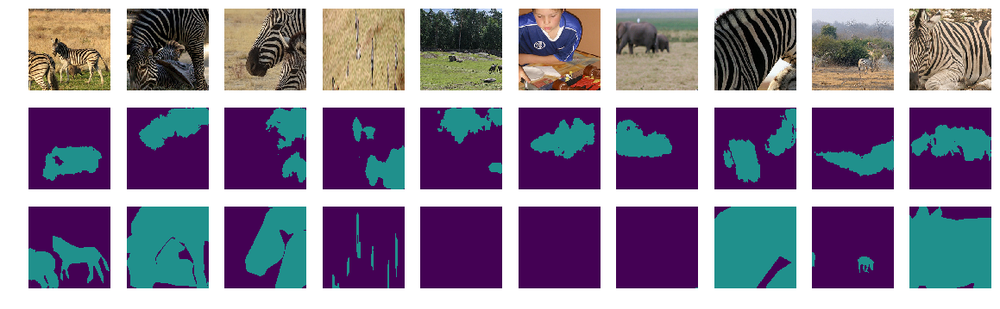

Loss on epoch 0 was: 0.44938585
Test accuracy after epoch 0 was: 0.65260882 +/- 0.18925754
Starting Epoch # 2
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


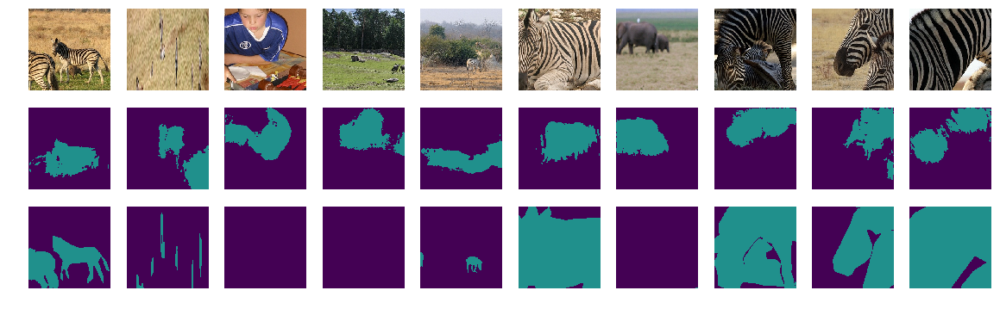

Loss on epoch 1 was: 0.38594416
Test accuracy after epoch 1 was: 0.64166733 +/- 0.18591091
Starting Epoch # 3
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


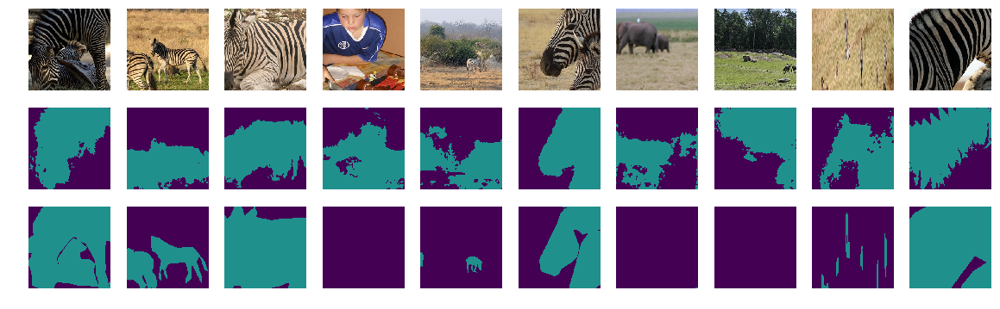

Loss on epoch 2 was: 0.25837475
Test accuracy after epoch 2 was: 0.65333626 +/- 0.15940271
Starting Epoch # 4
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


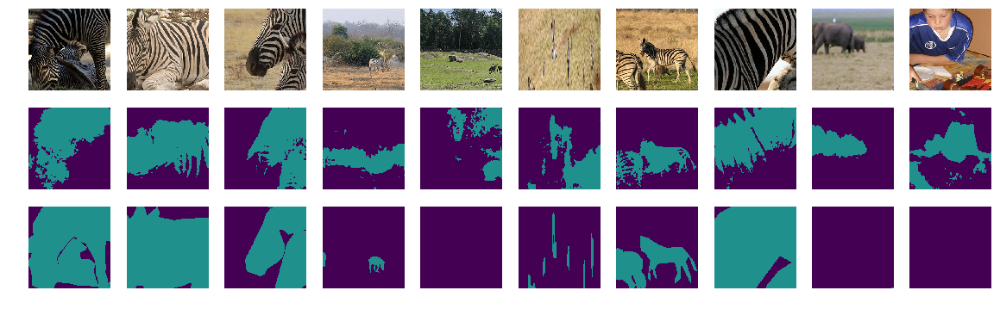

Loss on epoch 3 was: 0.22110114
Test accuracy after epoch 3 was: 0.74629903 +/- 0.10002348
Starting Epoch # 5
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


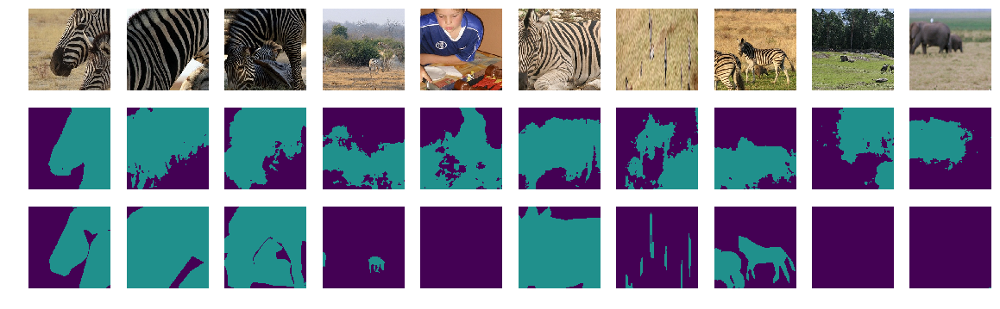

Loss on epoch 4 was: 0.17300025
Test accuracy after epoch 4 was: 0.68918806 +/- 0.15611711
Starting Epoch # 6
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


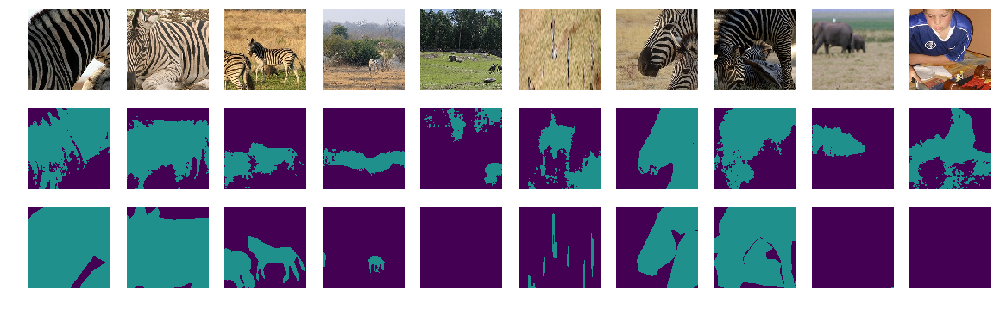

Loss on epoch 5 was: 0.22912611
Test accuracy after epoch 5 was: 0.77421476 +/- 0.11321146
Starting Epoch # 7
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


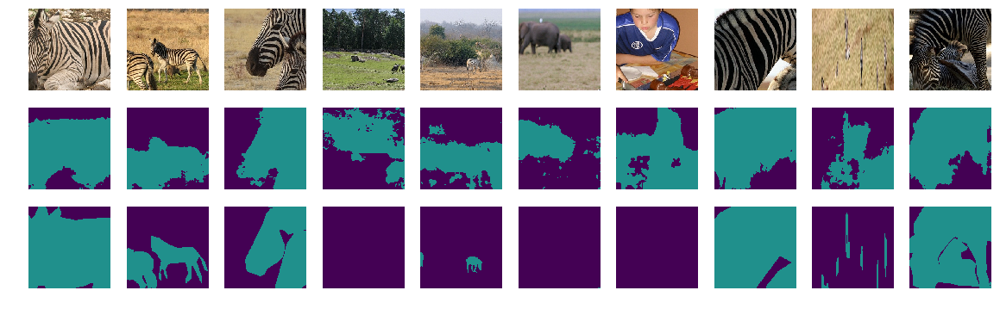

Loss on epoch 6 was: 0.25752491
Test accuracy after epoch 6 was: 0.70793208 +/- 0.17359231
Starting Epoch # 8
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


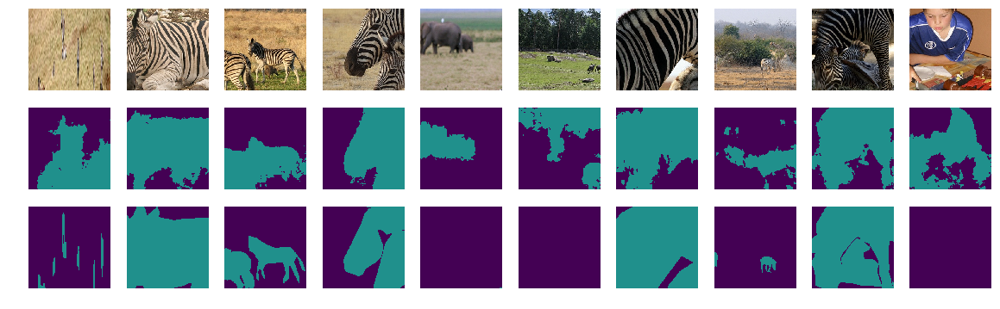

Loss on epoch 7 was: 0.22763386
Test accuracy after epoch 7 was: 0.74744898 +/- 0.14229563
Starting Epoch # 9
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


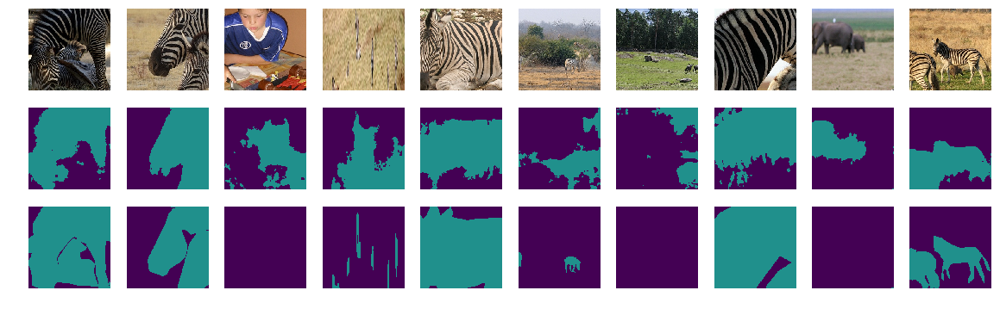

Loss on epoch 8 was: 0.13503955
Test accuracy after epoch 8 was: 0.76937978 +/- 0.09558685
Starting Epoch # 10
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


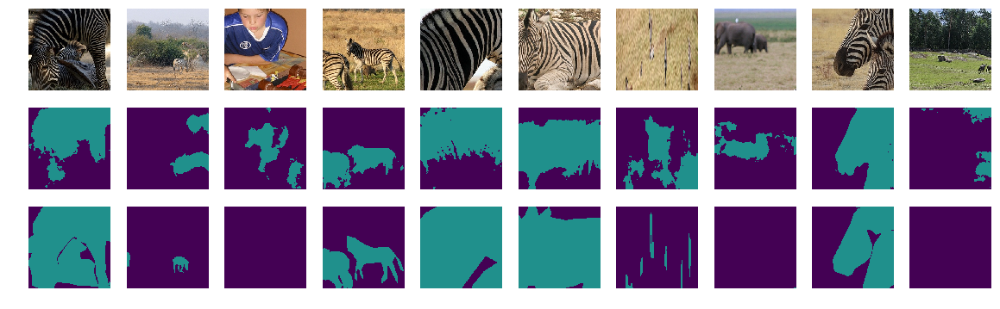

Loss on epoch 9 was: 0.20790020
Test accuracy after epoch 9 was: 0.80478715 +/- 0.10800966
Starting Epoch # 11
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


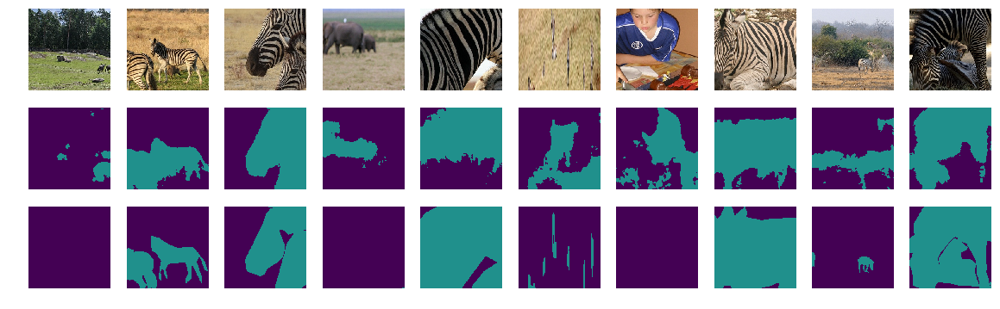

Loss on epoch 10 was: 0.24911691
Test accuracy after epoch 10 was: 0.79279536 +/- 0.11001834
Starting Epoch # 12
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


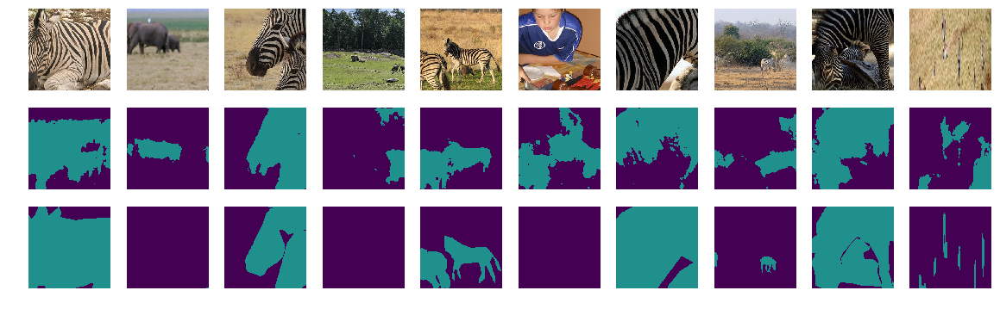

Loss on epoch 11 was: 0.13460408
Test accuracy after epoch 11 was: 0.80157047 +/- 0.11911731
Starting Epoch # 13
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


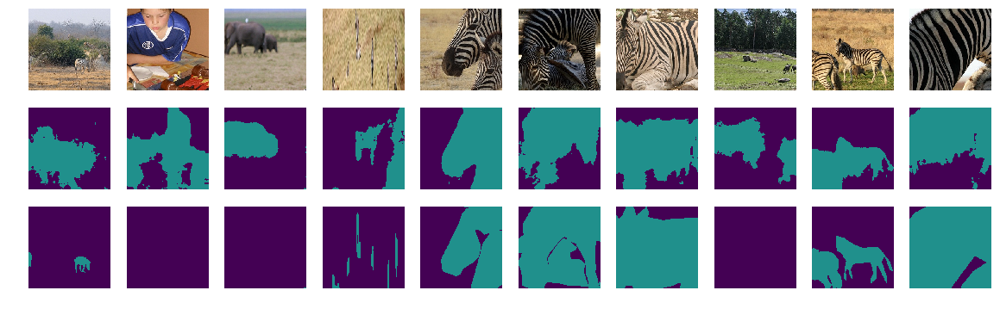

Loss on epoch 12 was: 0.16456200
Test accuracy after epoch 12 was: 0.73905054 +/- 0.13687918
Starting Epoch # 14
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


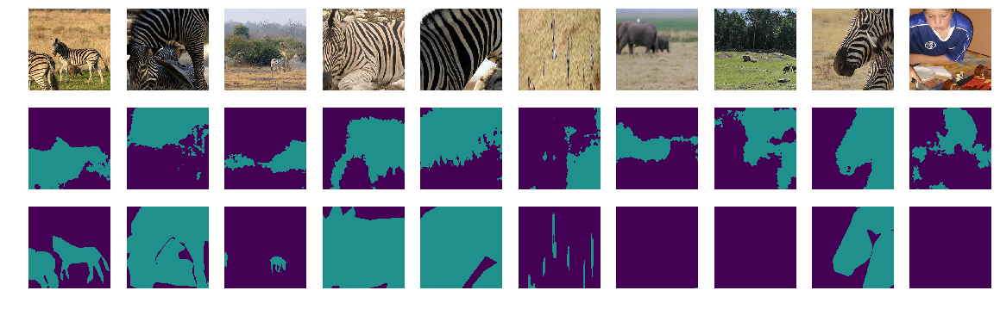

Loss on epoch 13 was: 0.35003734
Test accuracy after epoch 13 was: 0.71870018 +/- 0.13775050
Starting Epoch # 15
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


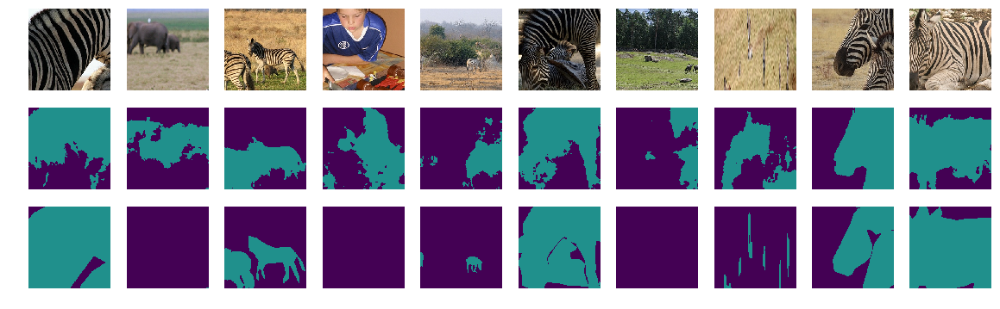

Loss on epoch 14 was: 0.26738706
Test accuracy after epoch 14 was: 0.75901228 +/- 0.11599769
Starting Epoch # 16
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


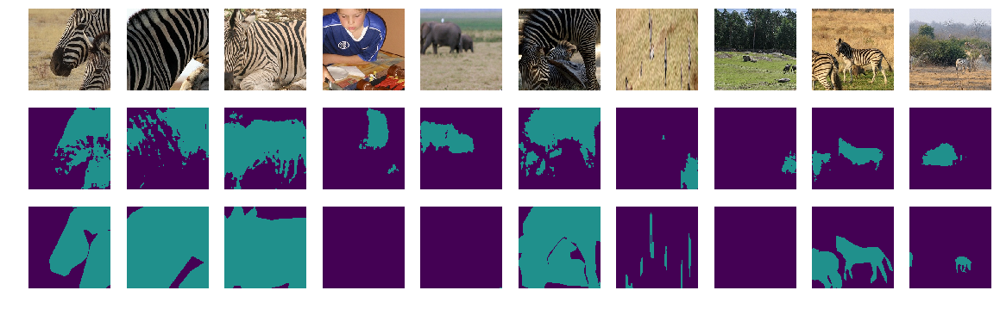

Loss on epoch 15 was: 0.46855527
Test accuracy after epoch 15 was: 0.78020169 +/- 0.16584129
Starting Epoch # 17
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


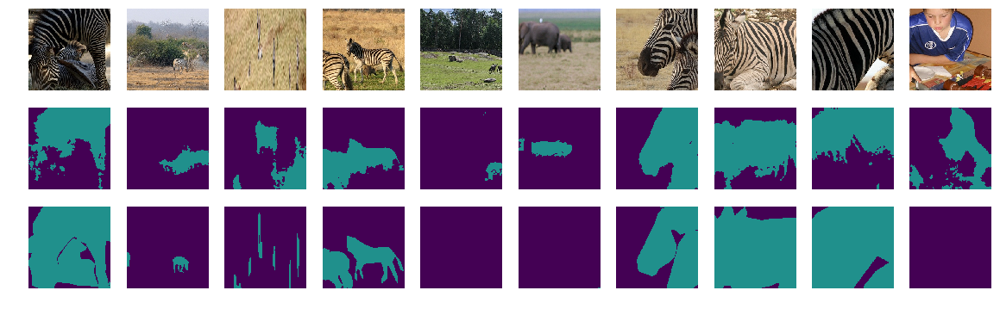

Loss on epoch 16 was: 0.12906785
Test accuracy after epoch 16 was: 0.80726443 +/- 0.13991079
Starting Epoch # 18
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


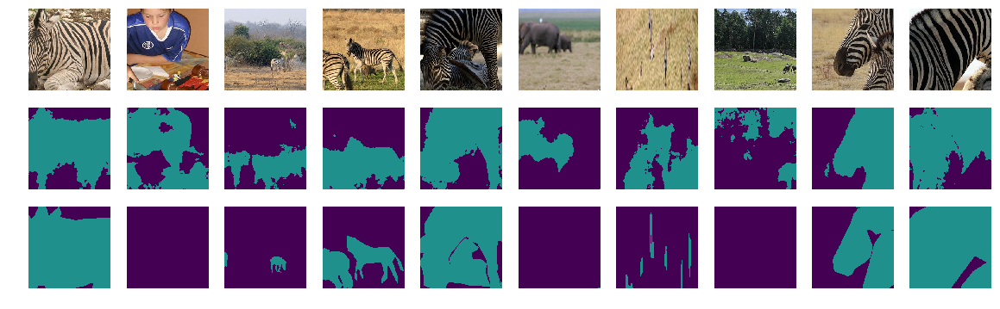

Loss on epoch 17 was: 0.25075141
Test accuracy after epoch 17 was: 0.74048948 +/- 0.15110450
Starting Epoch # 19
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


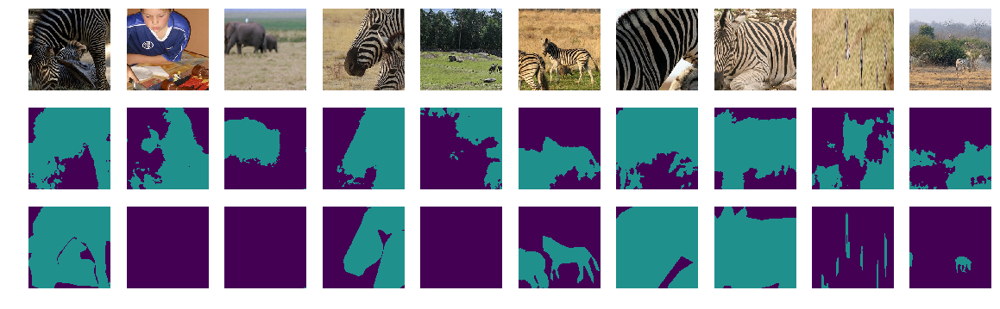

Loss on epoch 18 was: 0.19642247
Test accuracy after epoch 18 was: 0.73379504 +/- 0.13166008
Starting Epoch # 20
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


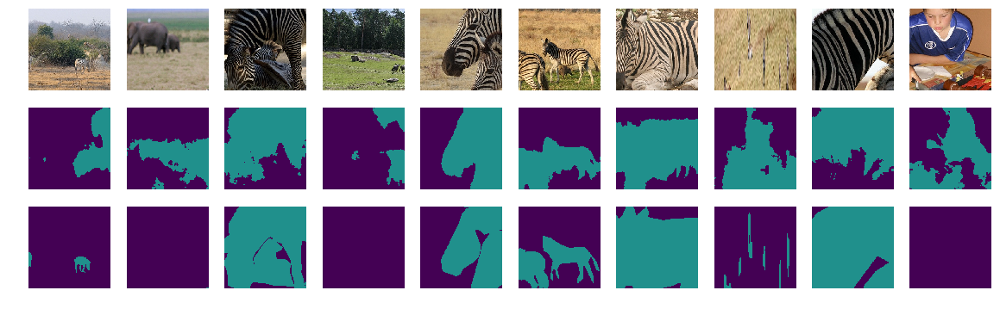

Loss on epoch 19 was: 0.19745179
Test accuracy after epoch 19 was: 0.75168806 +/- 0.13789129
Starting Epoch # 21
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


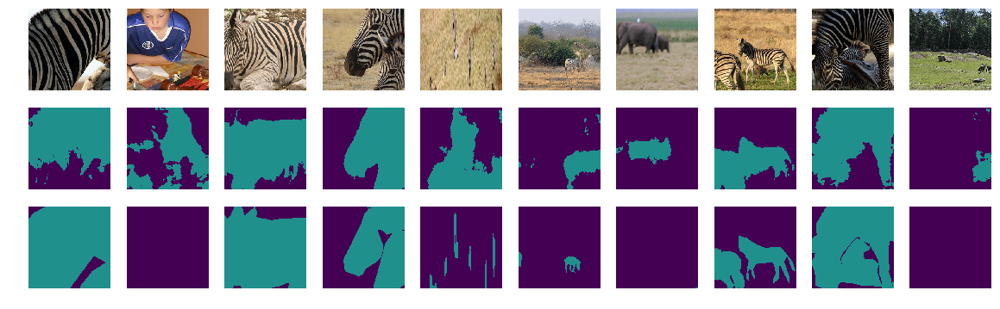

Loss on epoch 20 was: 0.09722485
Test accuracy after epoch 20 was: 0.80510403 +/- 0.13487305
Starting Epoch # 22
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


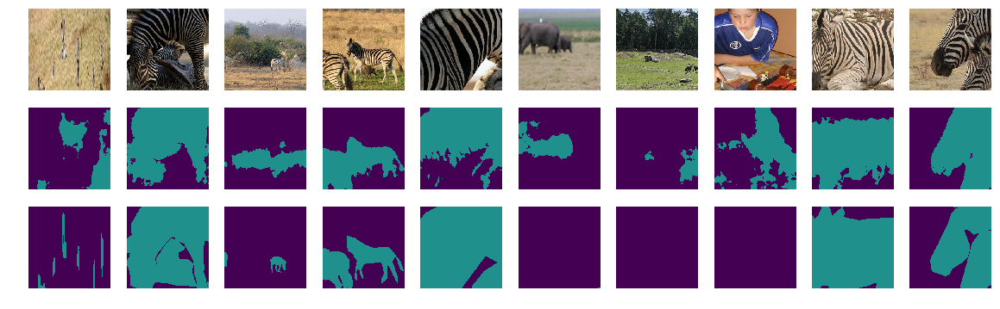

Loss on epoch 21 was: 0.25887132
Test accuracy after epoch 21 was: 0.81489557 +/- 0.10375663
Starting Epoch # 23
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


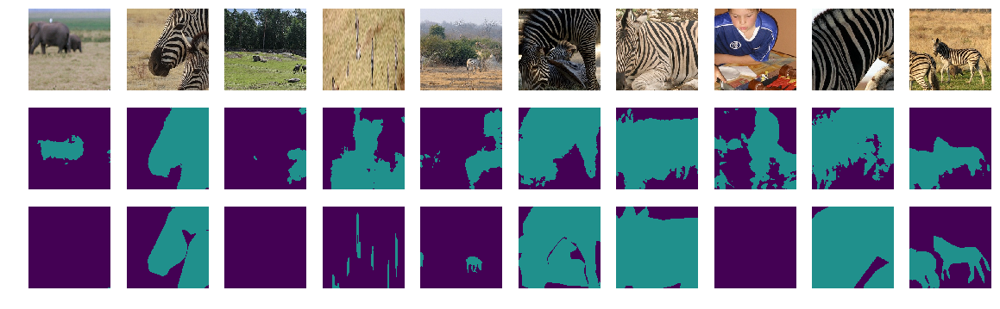

Loss on epoch 22 was: 0.13786797
Test accuracy after epoch 22 was: 0.79963927 +/- 0.13218797
Starting Epoch # 24
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


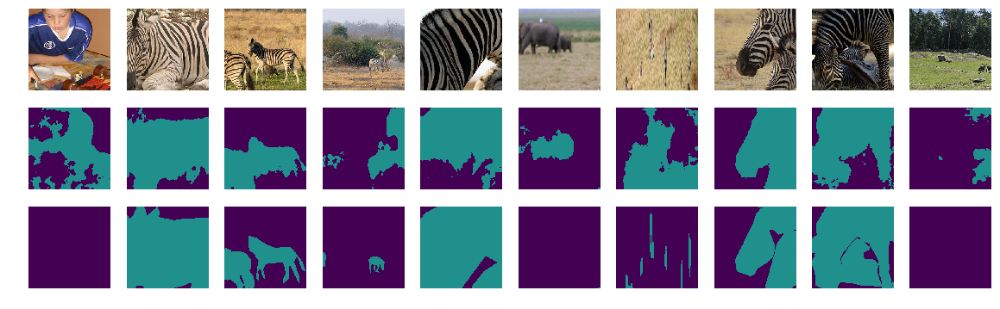

Loss on epoch 23 was: 0.10546125
Test accuracy after epoch 23 was: 0.78228436 +/- 0.14724066
Starting Epoch # 25
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


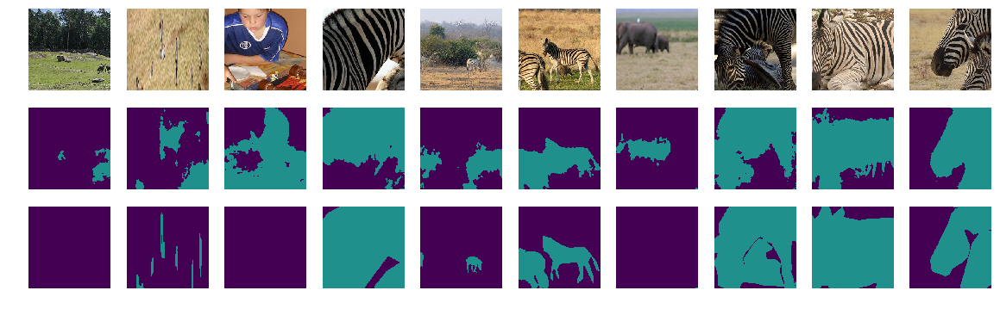

Loss on epoch 24 was: 0.08022559
Test accuracy after epoch 24 was: 0.80495456 +/- 0.15338974
Starting Epoch # 26
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


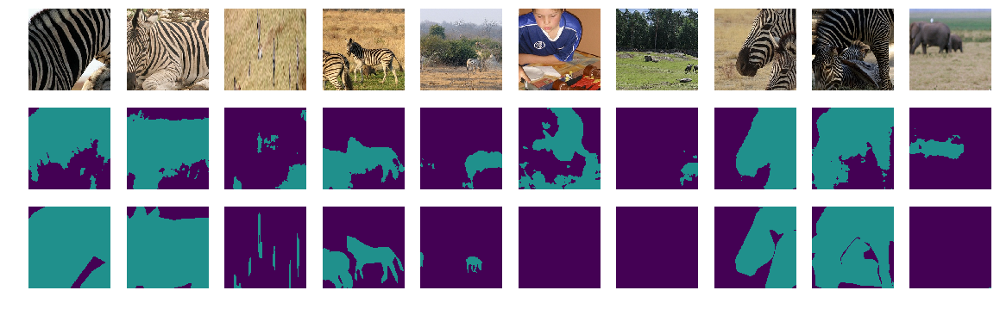

Loss on epoch 25 was: 0.10362829
Test accuracy after epoch 25 was: 0.83323103 +/- 0.12412002
Starting Epoch # 27
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


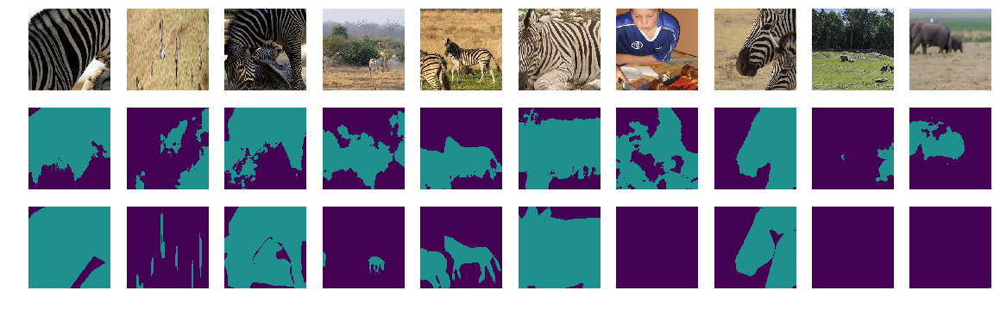

Loss on epoch 26 was: 0.12638672
Test accuracy after epoch 26 was: 0.76127830 +/- 0.15998908
Starting Epoch # 28
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


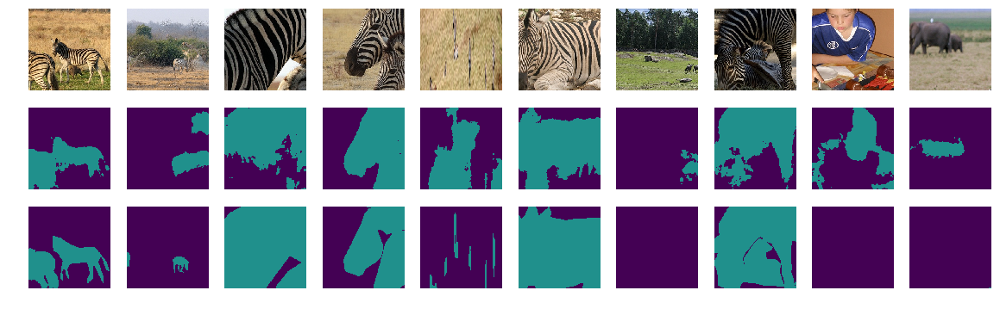

Loss on epoch 27 was: 0.17582057
Test accuracy after epoch 27 was: 0.82020687 +/- 0.11826665
Starting Epoch # 29
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


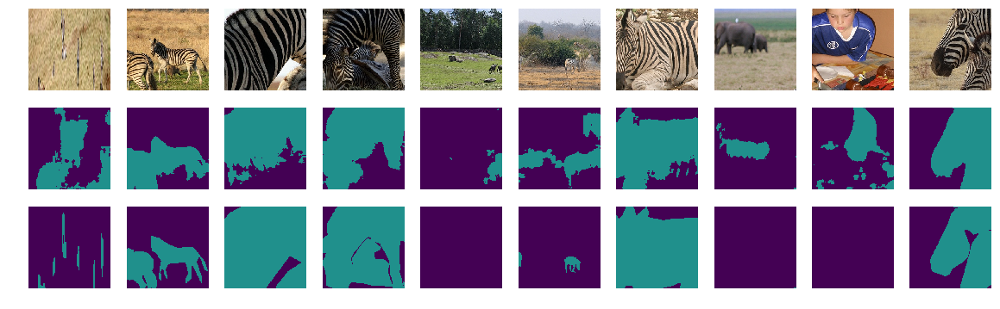

Loss on epoch 28 was: 0.14344522
Test accuracy after epoch 28 was: 0.82506975 +/- 0.09406276
Starting Epoch # 30
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


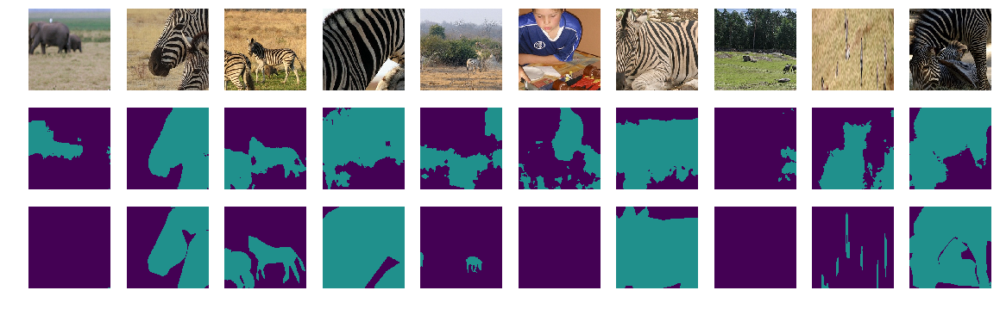

Loss on epoch 29 was: 0.10340215
Test accuracy after epoch 29 was: 0.80513991 +/- 0.11224955
Starting Epoch # 31
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


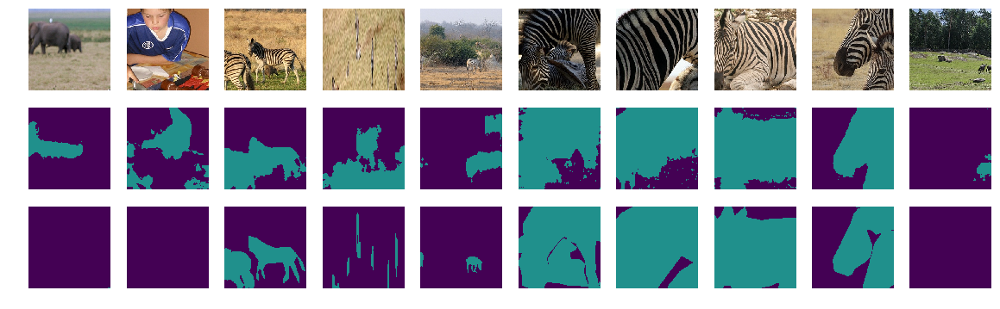

Loss on epoch 30 was: 0.10323361
Test accuracy after epoch 30 was: 0.84329361 +/- 0.10447353
Starting Epoch # 32
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


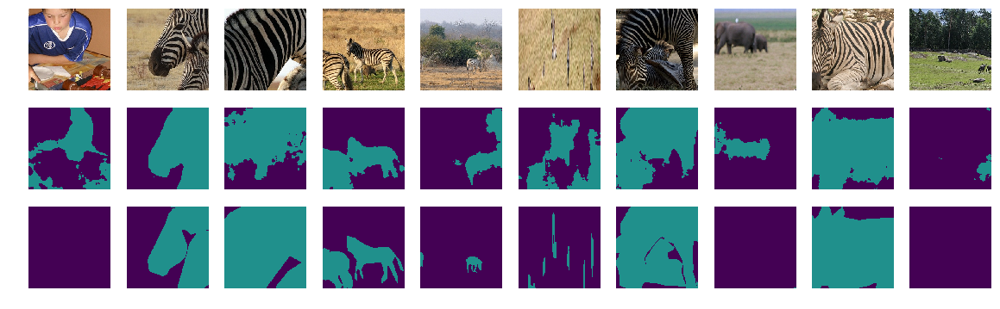

Loss on epoch 31 was: 0.10343037
Test accuracy after epoch 31 was: 0.83246971 +/- 0.10655516
Starting Epoch # 33
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


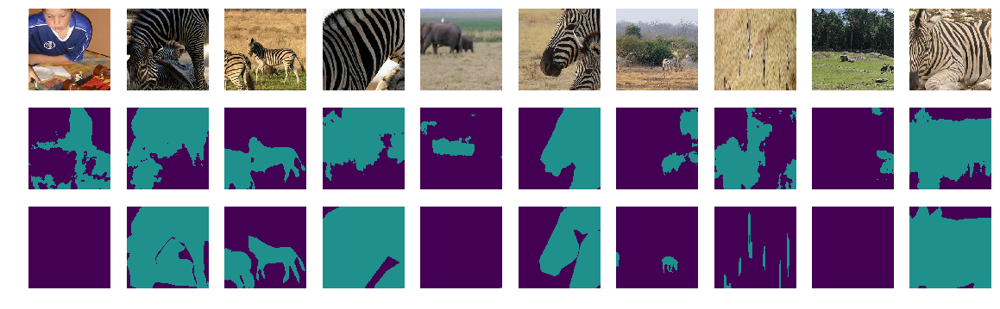

Loss on epoch 32 was: 0.07768852
Test accuracy after epoch 32 was: 0.81118264 +/- 0.12906751
Starting Epoch # 34
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


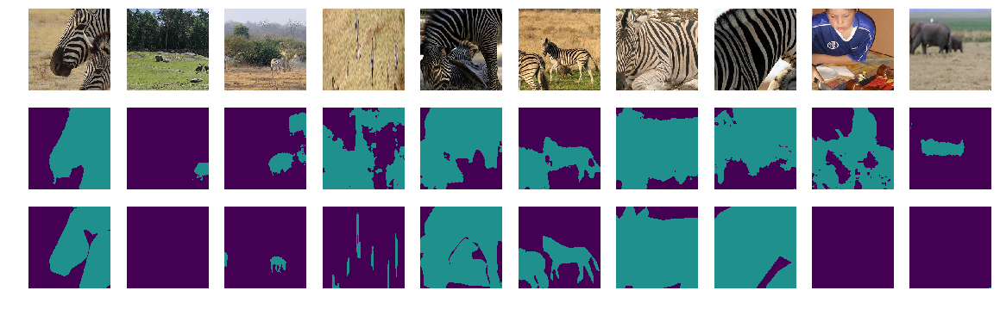

Loss on epoch 33 was: 0.06694309
Test accuracy after epoch 33 was: 0.79719986 +/- 0.19789683
Starting Epoch # 35
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


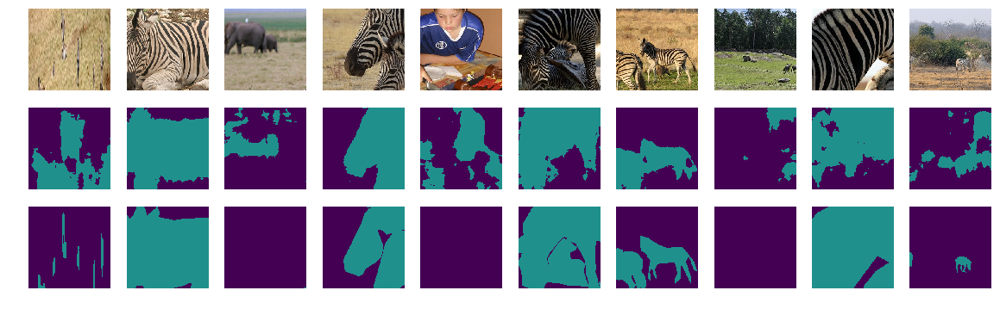

Loss on epoch 34 was: 0.13566291
Test accuracy after epoch 34 was: 0.79944994 +/- 0.11350261
Starting Epoch # 36
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


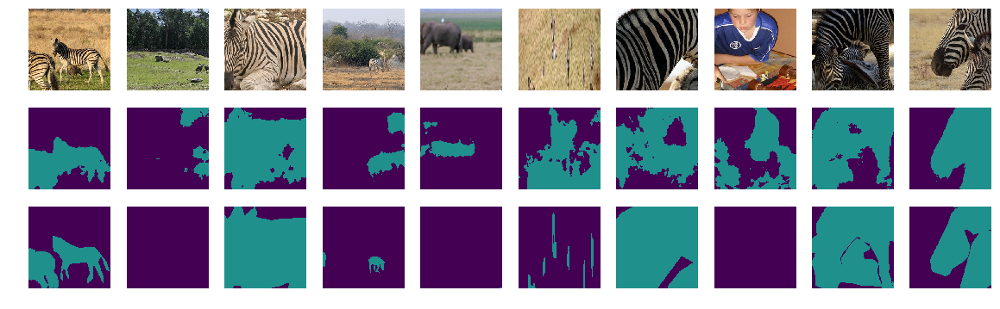

Loss on epoch 35 was: 0.21608469
Test accuracy after epoch 35 was: 0.79773597 +/- 0.14665742
Starting Epoch # 37
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


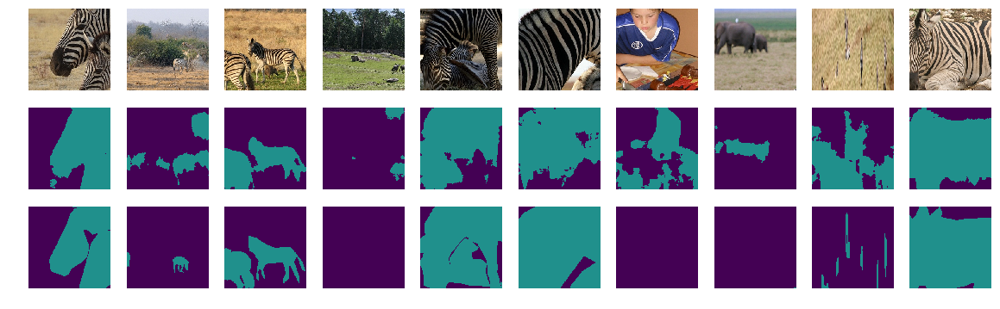

Loss on epoch 36 was: 0.07821451
Test accuracy after epoch 36 was: 0.82234933 +/- 0.13735598
Starting Epoch # 38
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


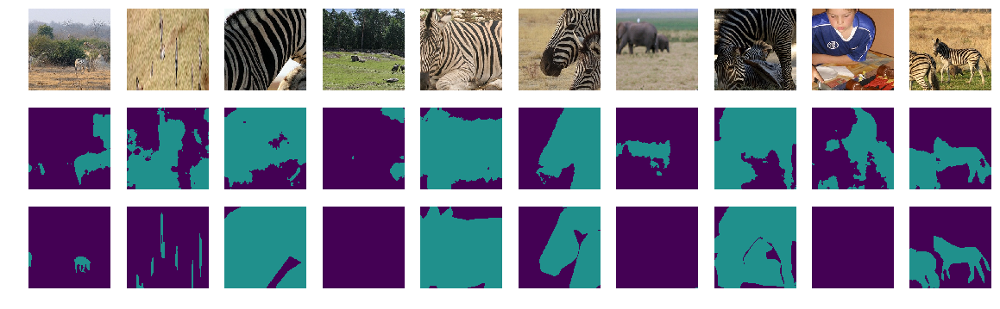

Loss on epoch 37 was: 0.06573904
Test accuracy after epoch 37 was: 0.82228755 +/- 0.13185727
Starting Epoch # 39
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


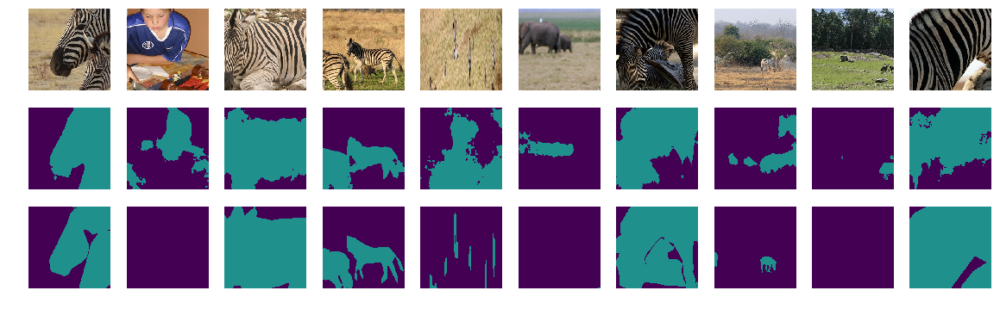

Loss on epoch 38 was: 0.09741500
Test accuracy after epoch 38 was: 0.82971739 +/- 0.12560900
Starting Epoch # 40
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


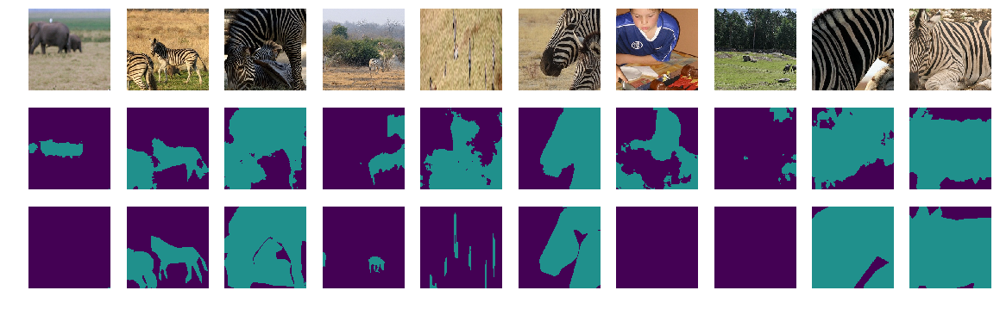

Loss on epoch 39 was: 0.09406192
Test accuracy after epoch 39 was: 0.82310866 +/- 0.14016098
Starting Epoch # 41
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


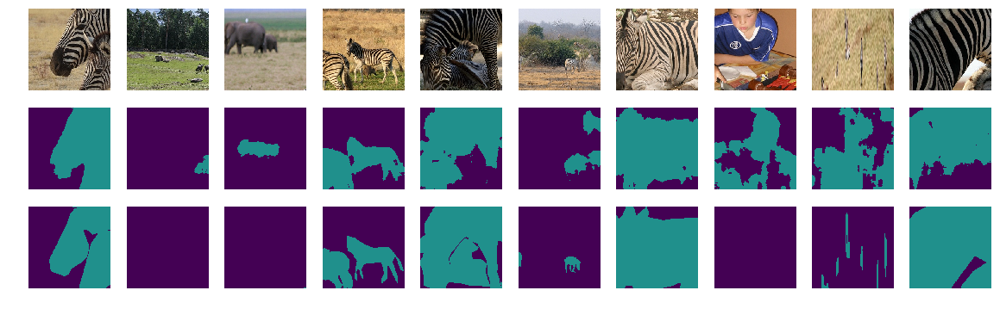

Loss on epoch 40 was: 0.09883653
Test accuracy after epoch 40 was: 0.81526028 +/- 0.16577891
Starting Epoch # 42
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


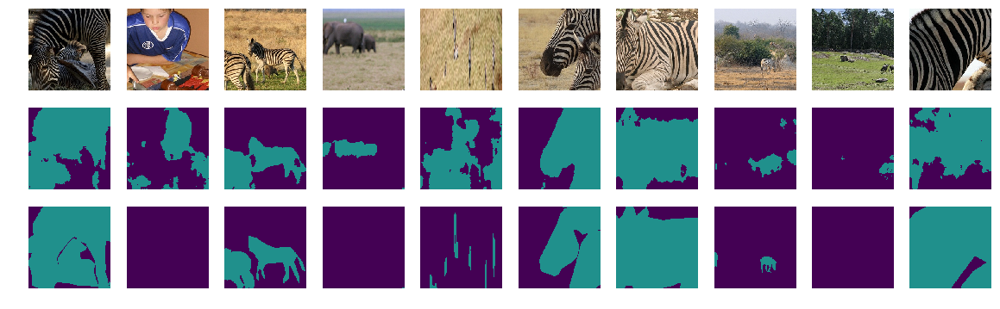

Loss on epoch 41 was: 0.06090722
Test accuracy after epoch 41 was: 0.84077846 +/- 0.12698489
Starting Epoch # 43
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


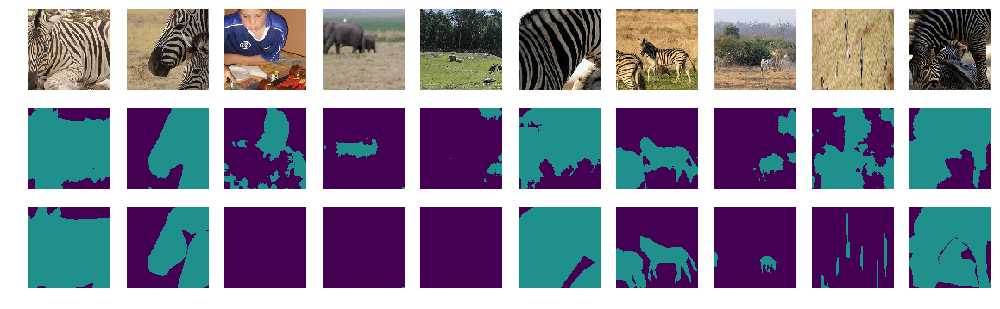

Loss on epoch 42 was: 0.08161265
Test accuracy after epoch 42 was: 0.83574219 +/- 0.13660755
Starting Epoch # 44
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


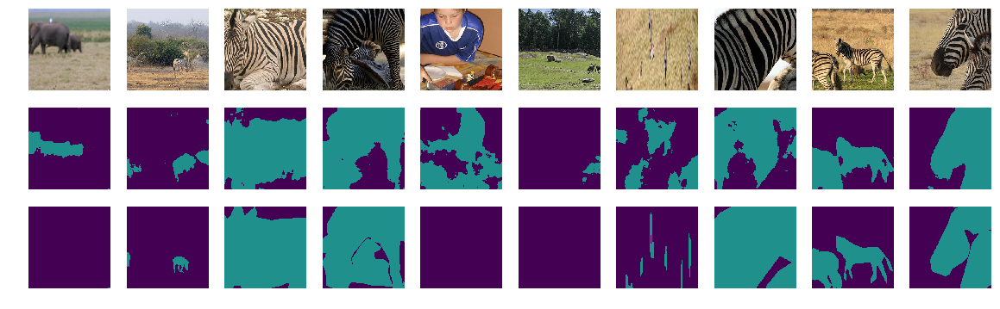

Loss on epoch 43 was: 0.09653509
Test accuracy after epoch 43 was: 0.82380222 +/- 0.14653003
Starting Epoch # 45
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


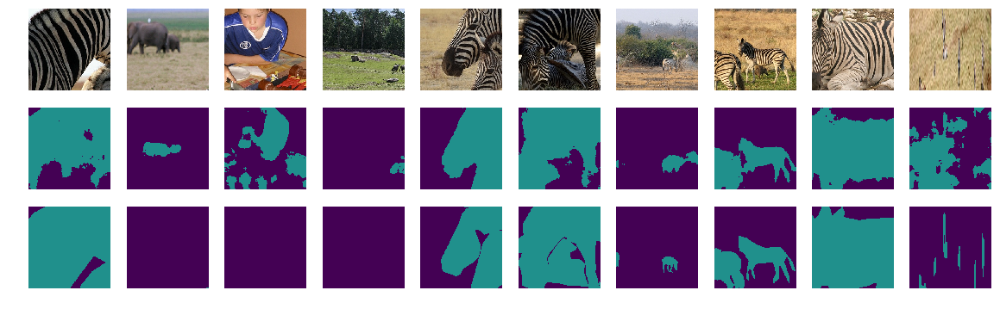

Loss on epoch 44 was: 0.07126875
Test accuracy after epoch 44 was: 0.84986248 +/- 0.13124332
Starting Epoch # 46
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


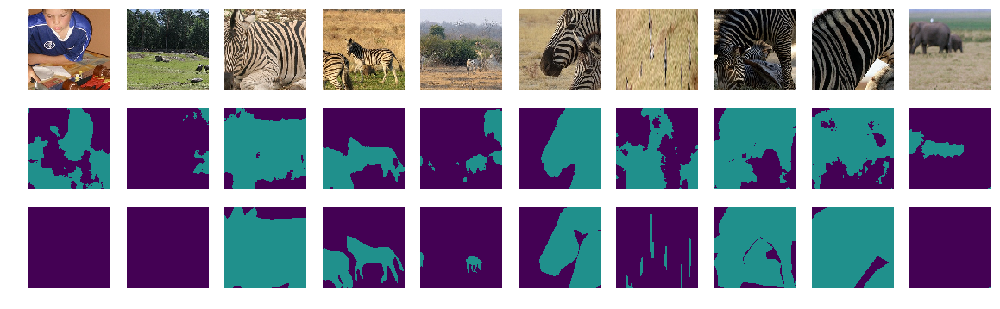

Loss on epoch 45 was: 0.08538920
Test accuracy after epoch 45 was: 0.80860571 +/- 0.14955473
Starting Epoch # 47
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


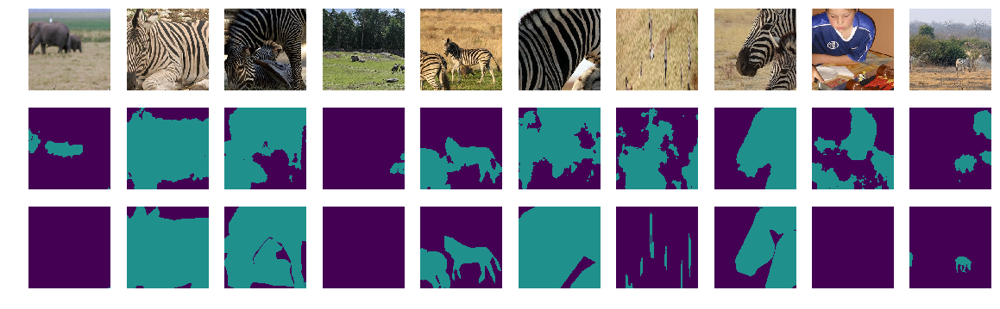

Loss on epoch 46 was: 0.08482128
Test accuracy after epoch 46 was: 0.82009128 +/- 0.14273054
Starting Epoch # 48
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


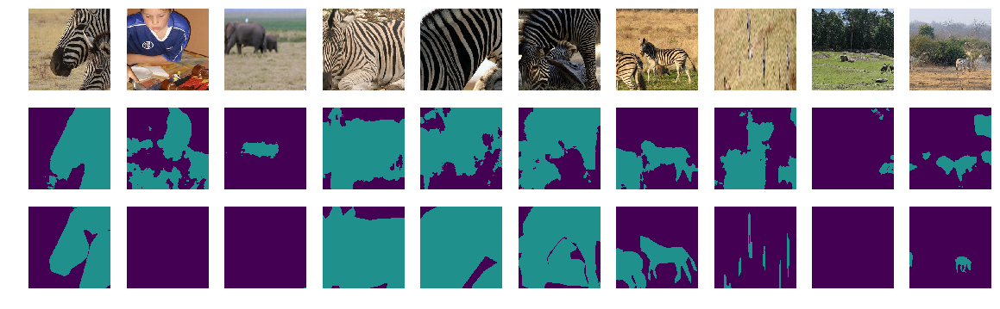

Loss on epoch 47 was: 0.07068951
Test accuracy after epoch 47 was: 0.81759407 +/- 0.14092824
Starting Epoch # 49
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


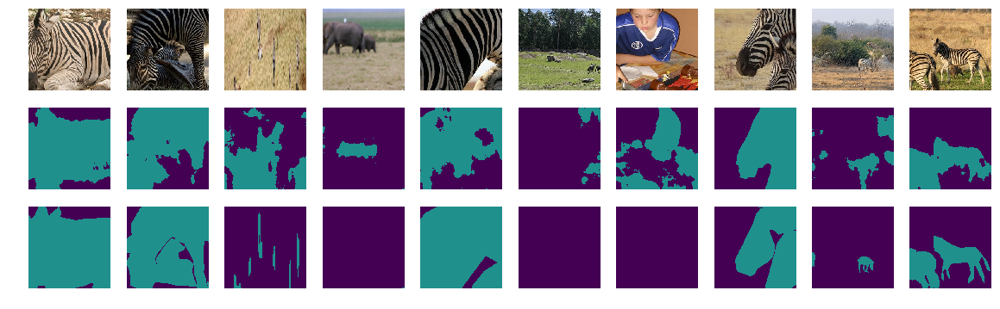

Loss on epoch 48 was: 0.06504601
Test accuracy after epoch 48 was: 0.82058155 +/- 0.13426423
Starting Epoch # 50
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


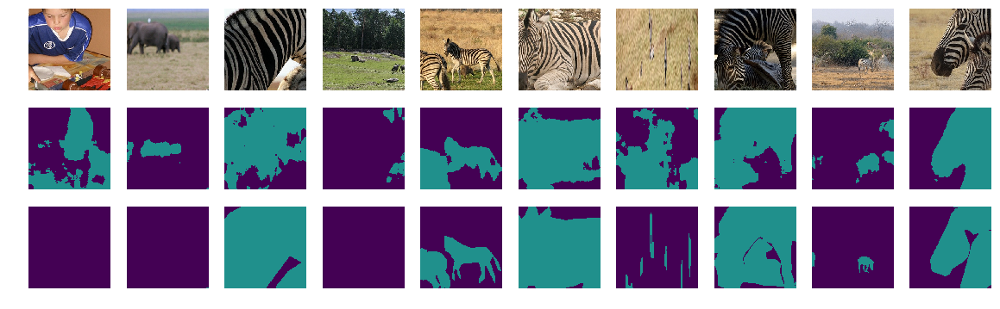

Loss on epoch 49 was: 0.05802048
Test accuracy after epoch 49 was: 0.82441207 +/- 0.14584332
Starting Epoch # 51
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


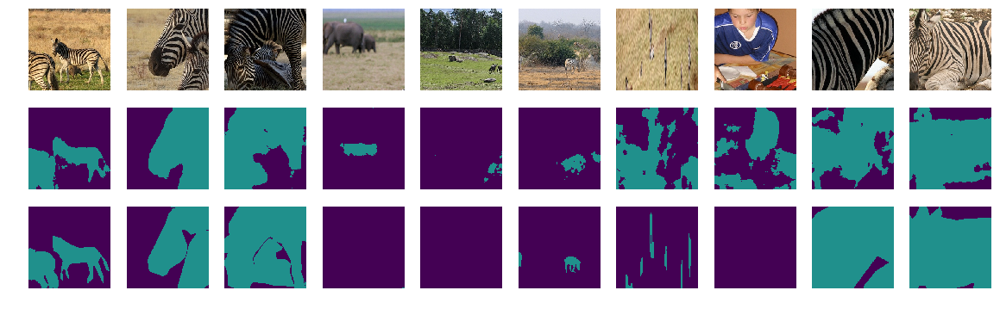

Loss on epoch 50 was: 0.06480873
Test accuracy after epoch 50 was: 0.83356386 +/- 0.15065532
Starting Epoch # 52
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


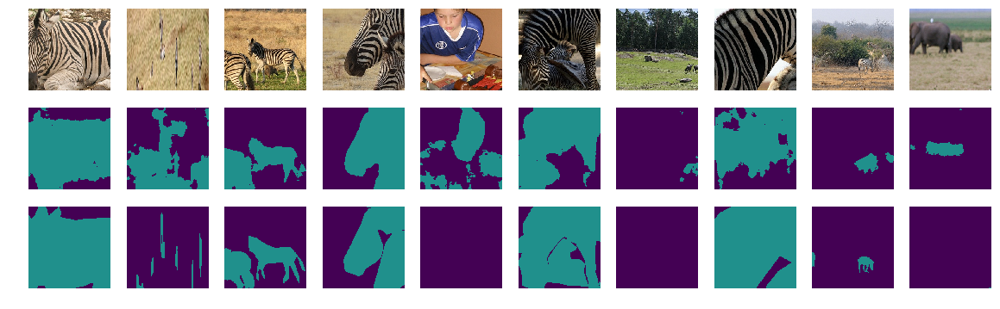

Loss on epoch 51 was: 0.05007796
Test accuracy after epoch 51 was: 0.84184471 +/- 0.13653067
Starting Epoch # 53
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


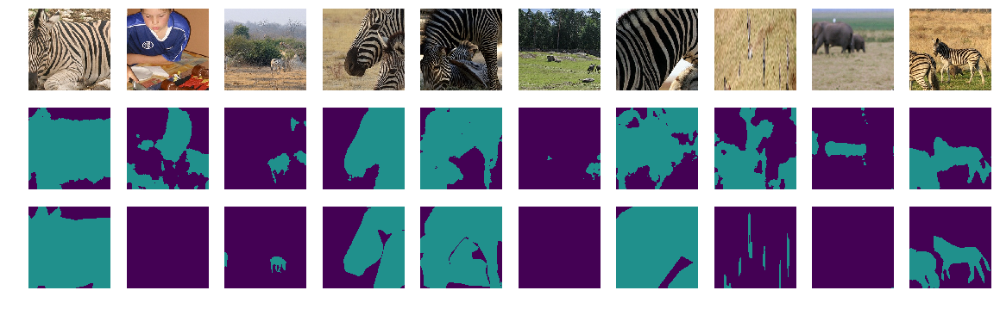

Loss on epoch 52 was: 0.05670720
Test accuracy after epoch 52 was: 0.83105668 +/- 0.14367931
Starting Epoch # 54
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


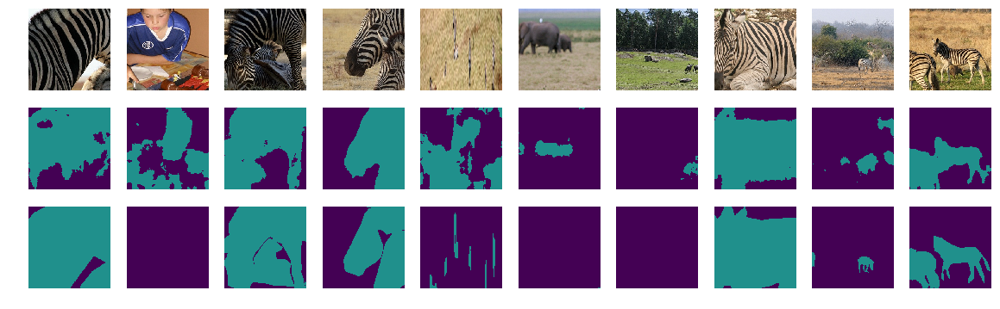

Loss on epoch 53 was: 0.03730906
Test accuracy after epoch 53 was: 0.82853555 +/- 0.15163992
Starting Epoch # 55
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


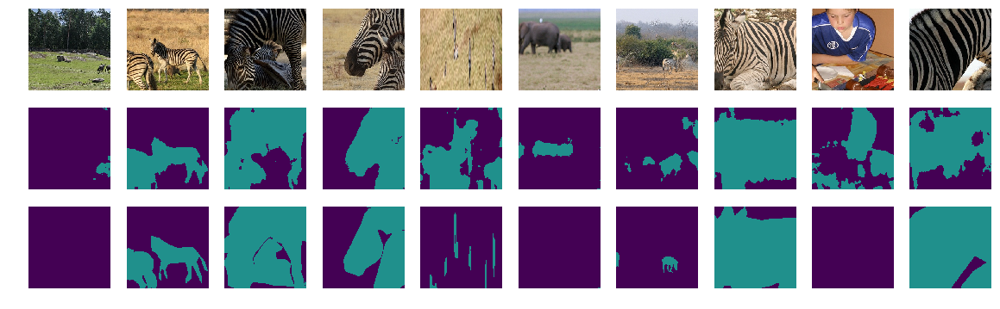

Loss on epoch 54 was: 0.06249472
Test accuracy after epoch 54 was: 0.82929289 +/- 0.13242827
Starting Epoch # 56
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


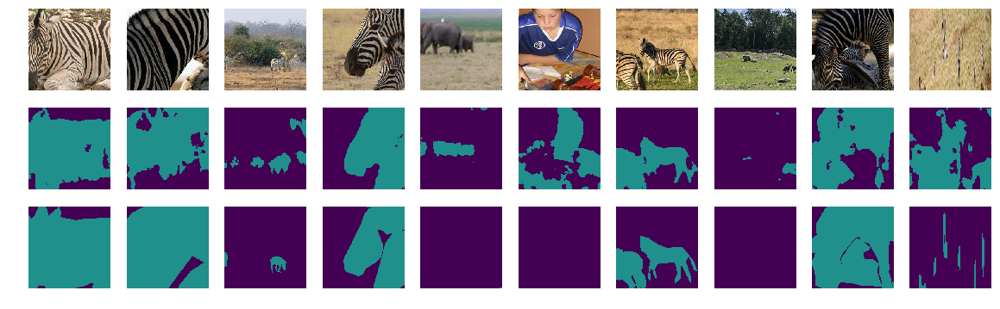

Loss on epoch 55 was: 0.04035604
Test accuracy after epoch 55 was: 0.82406330 +/- 0.14129945
Starting Epoch # 57
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


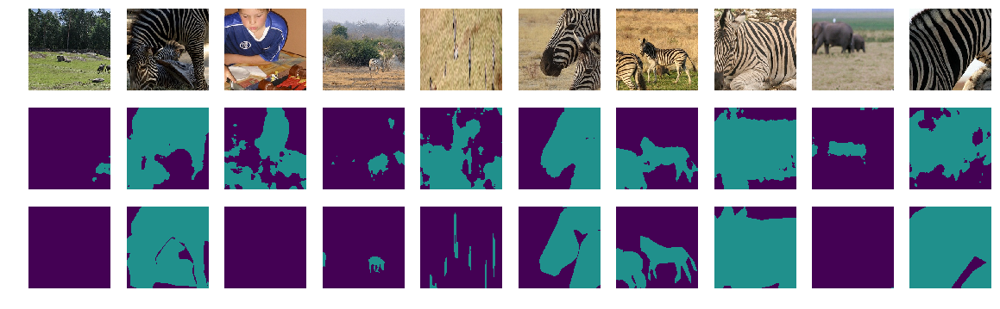

Loss on epoch 56 was: 0.04660212
Test accuracy after epoch 56 was: 0.82241311 +/- 0.15499662
Starting Epoch # 58
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


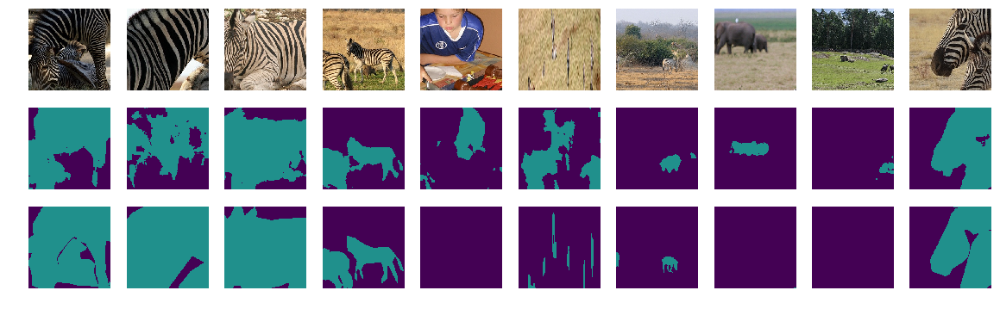

Loss on epoch 57 was: 0.08455339
Test accuracy after epoch 57 was: 0.85229791 +/- 0.12297002
Starting Epoch # 59
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


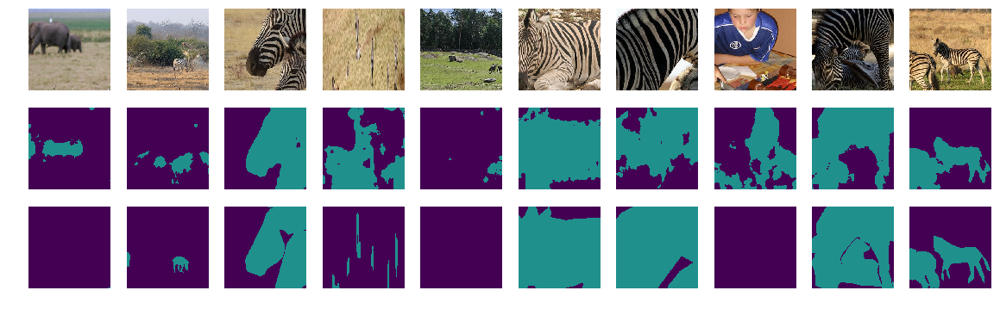

Loss on epoch 58 was: 0.02548404
Test accuracy after epoch 58 was: 0.82168168 +/- 0.14516330
Starting Epoch # 60
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


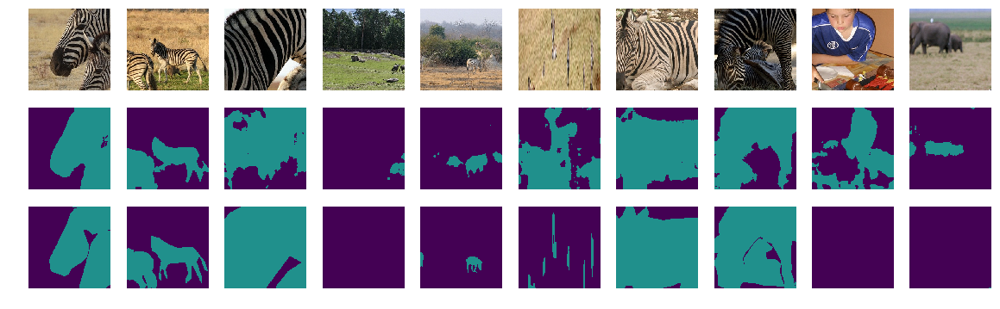

Loss on epoch 59 was: 0.03522602
Test accuracy after epoch 59 was: 0.83152304 +/- 0.14782887
Starting Epoch # 61
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


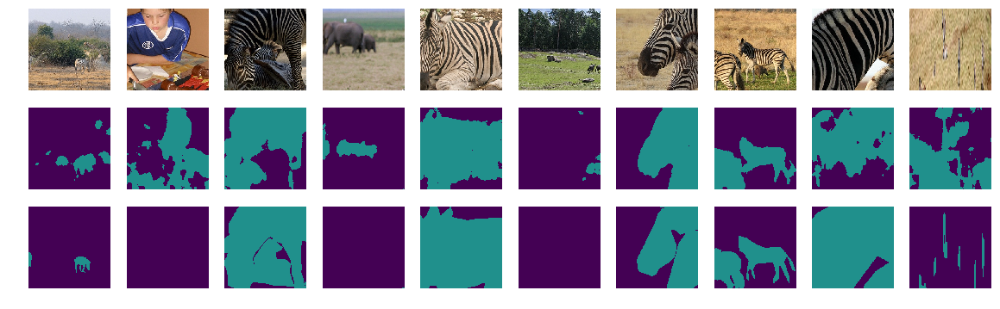

Loss on epoch 60 was: 0.03080514
Test accuracy after epoch 60 was: 0.81639828 +/- 0.15494244
Starting Epoch # 62
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


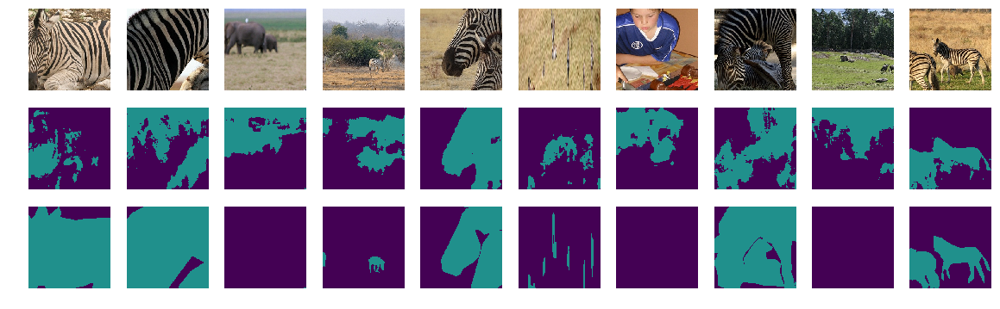

Loss on epoch 61 was: 0.28215525
Test accuracy after epoch 61 was: 0.66859056 +/- 0.18848249
Starting Epoch # 63
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


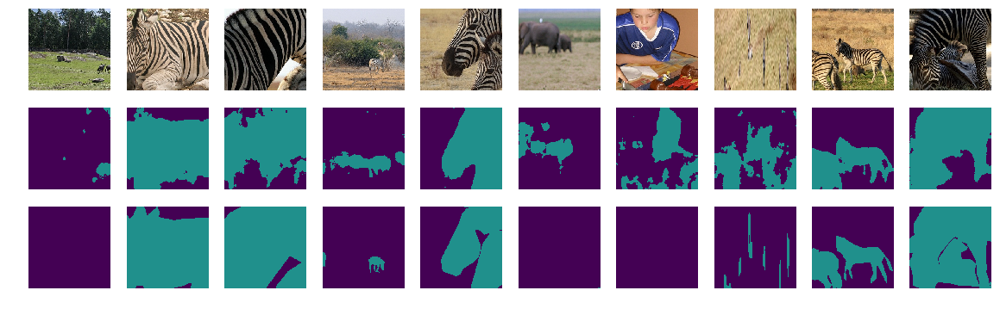

Loss on epoch 62 was: 0.05159558
Test accuracy after epoch 62 was: 0.83814373 +/- 0.10965556
Starting Epoch # 64
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


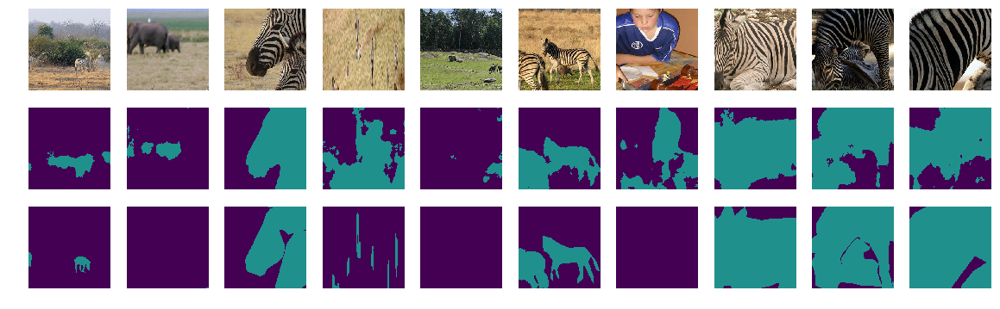

Loss on epoch 63 was: 0.03927241
Test accuracy after epoch 63 was: 0.82536472 +/- 0.14014334
Starting Epoch # 65
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


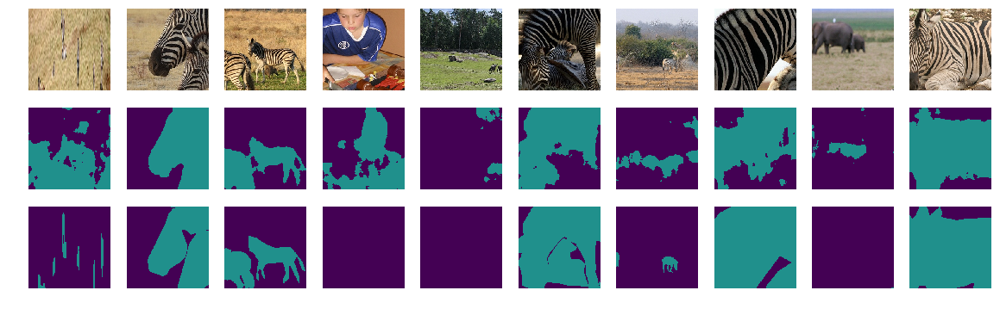

Loss on epoch 64 was: 0.05353544
Test accuracy after epoch 64 was: 0.80911790 +/- 0.15432700
Starting Epoch # 66
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


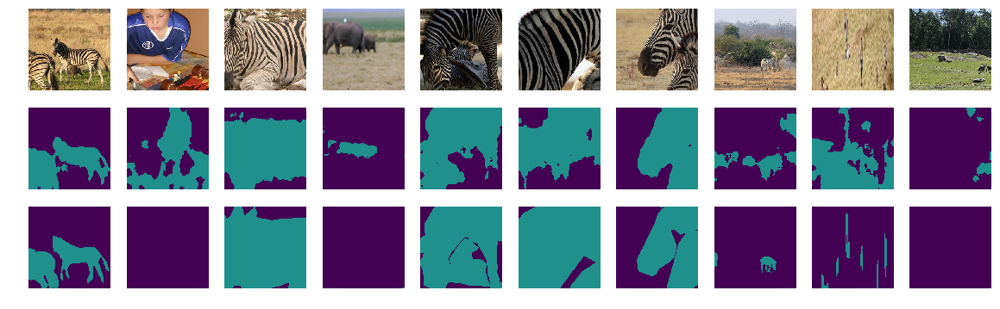

Loss on epoch 65 was: 0.05615563
Test accuracy after epoch 65 was: 0.81322545 +/- 0.14530034
Starting Epoch # 67
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


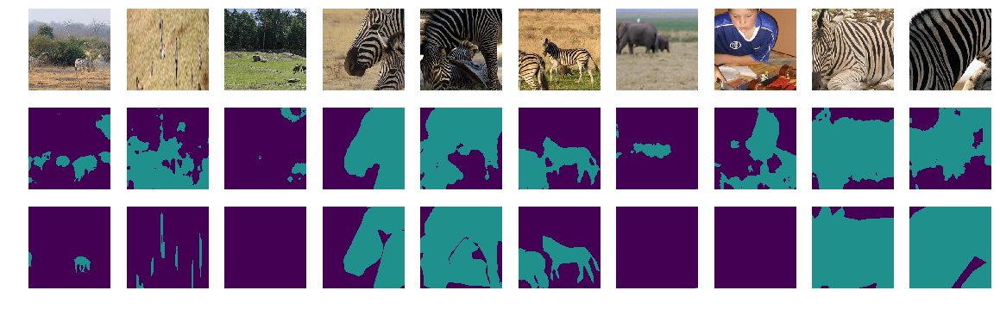

Loss on epoch 66 was: 0.04128220
Test accuracy after epoch 66 was: 0.81535595 +/- 0.14414691
Starting Epoch # 68
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


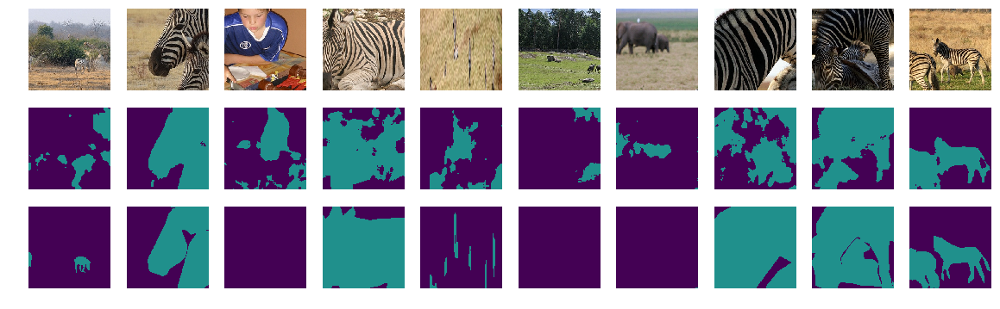

Loss on epoch 67 was: 0.08159447
Test accuracy after epoch 67 was: 0.81591199 +/- 0.12607870
Starting Epoch # 69
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


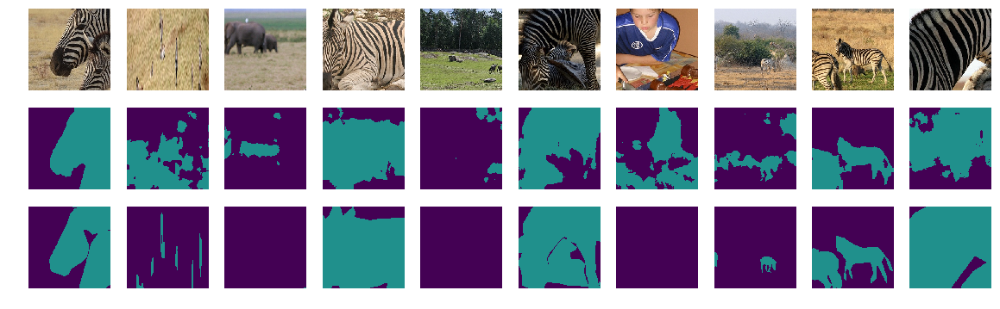

Loss on epoch 68 was: 0.04030337
Test accuracy after epoch 68 was: 0.80487683 +/- 0.14184941
Starting Epoch # 70
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


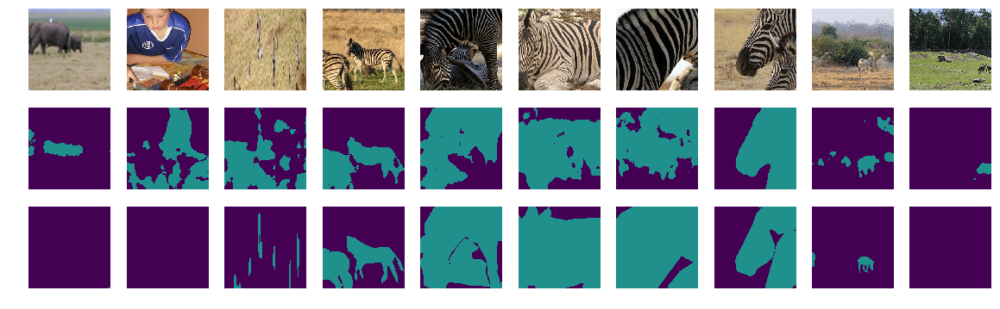

Loss on epoch 69 was: 0.02636557
Test accuracy after epoch 69 was: 0.82292730 +/- 0.13592998
Starting Epoch # 71
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


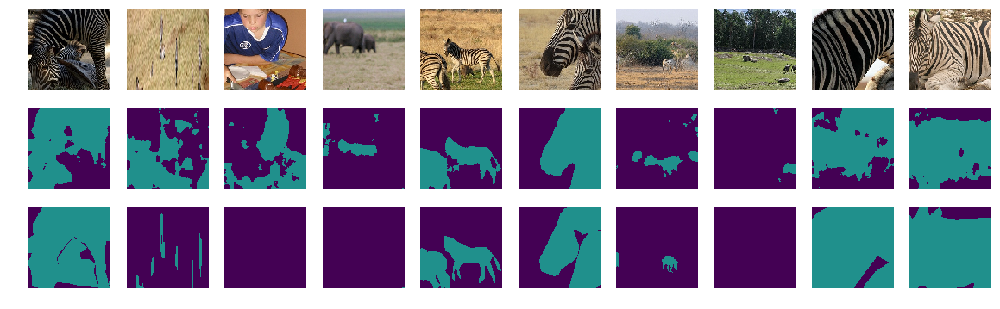

Loss on epoch 70 was: 0.04720836
Test accuracy after epoch 70 was: 0.81826371 +/- 0.14811892
Starting Epoch # 72
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


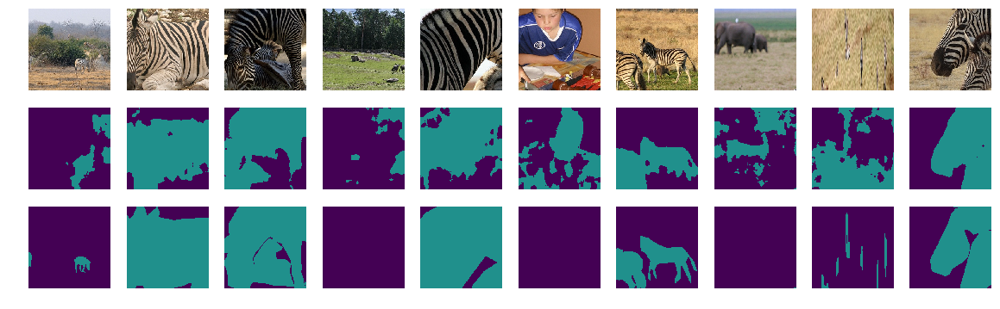

Loss on epoch 71 was: 0.04101821
Test accuracy after epoch 71 was: 0.78753986 +/- 0.12911519
Starting Epoch # 73
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


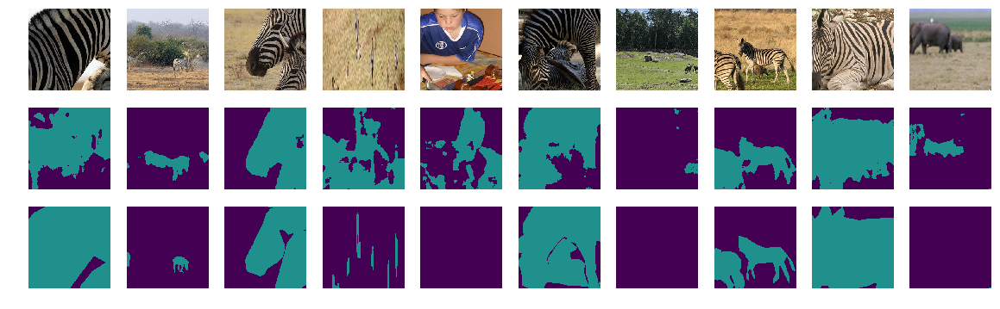

Loss on epoch 72 was: 0.02979466
Test accuracy after epoch 72 was: 0.81955915 +/- 0.14080420
Starting Epoch # 74
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


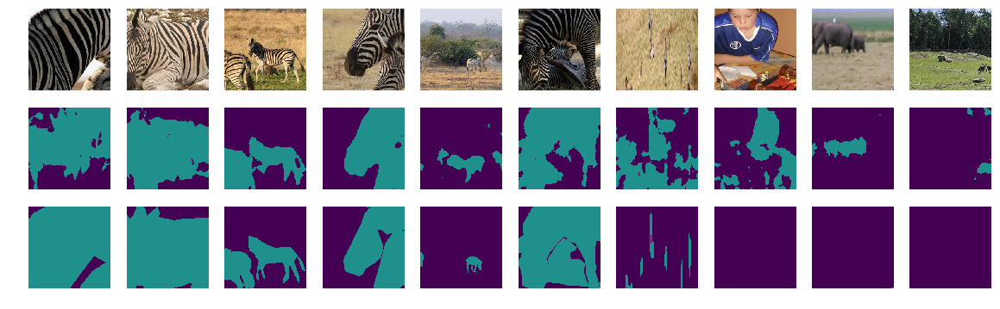

Loss on epoch 73 was: 0.04353759
Test accuracy after epoch 73 was: 0.82907765 +/- 0.12495777
Starting Epoch # 75
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


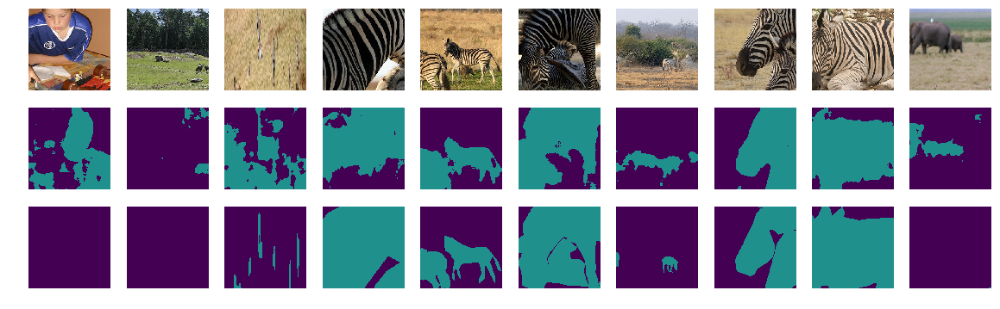

Loss on epoch 74 was: 0.04432162
Test accuracy after epoch 74 was: 0.81758211 +/- 0.14038492
Starting Epoch # 76
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


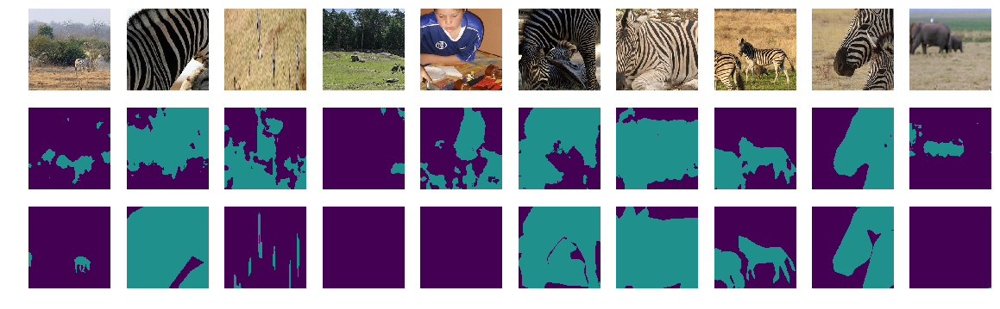

Loss on epoch 75 was: 0.03139921
Test accuracy after epoch 75 was: 0.82178532 +/- 0.13548789
Starting Epoch # 77
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


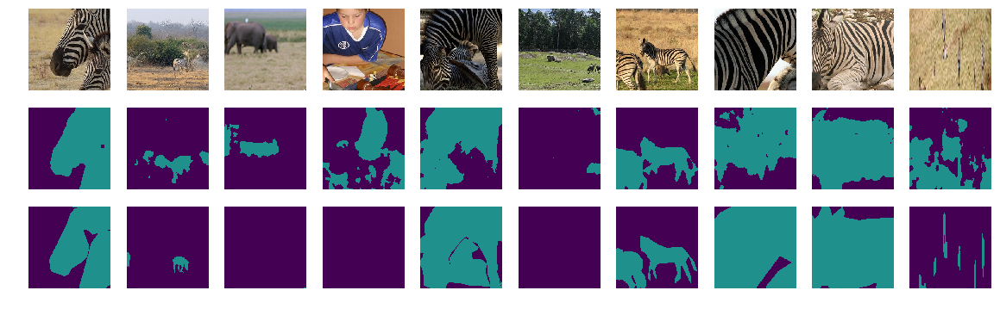

Loss on epoch 76 was: 0.02845784
Test accuracy after epoch 76 was: 0.83024753 +/- 0.12323234
Starting Epoch # 78
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


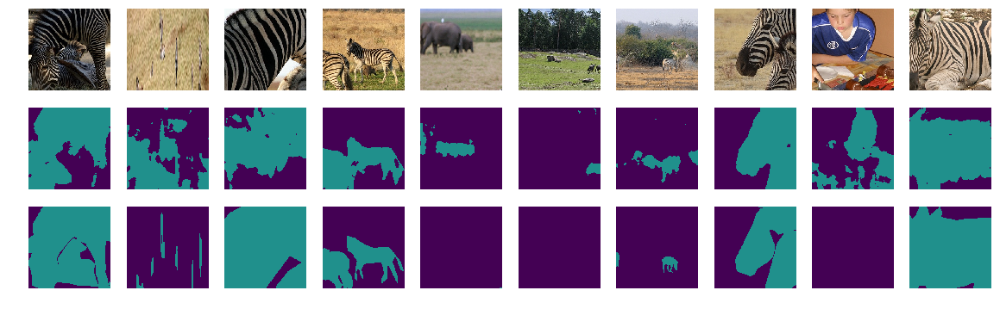

Loss on epoch 77 was: 0.01589122
Test accuracy after epoch 77 was: 0.82784200 +/- 0.13356309
Starting Epoch # 79
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


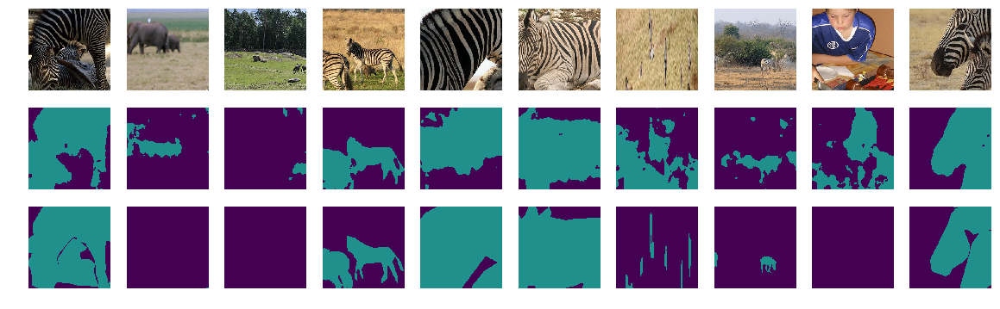

Loss on epoch 78 was: 0.01879868
Test accuracy after epoch 78 was: 0.82184909 +/- 0.13655474
Starting Epoch # 80
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


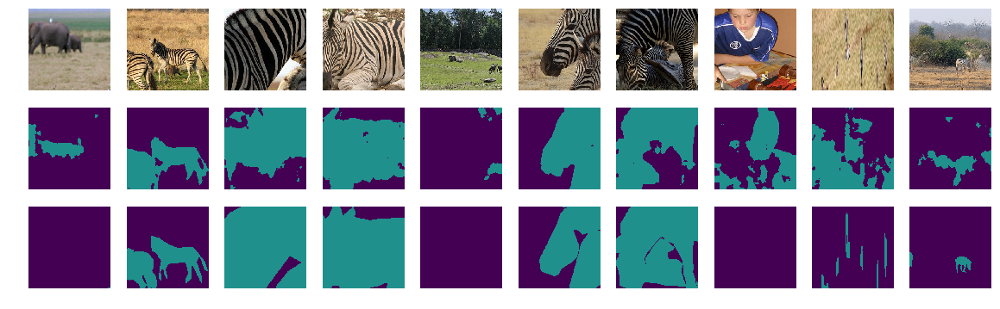

Loss on epoch 79 was: 0.01972475
Test accuracy after epoch 79 was: 0.81742666 +/- 0.13417145
Starting Epoch # 81
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


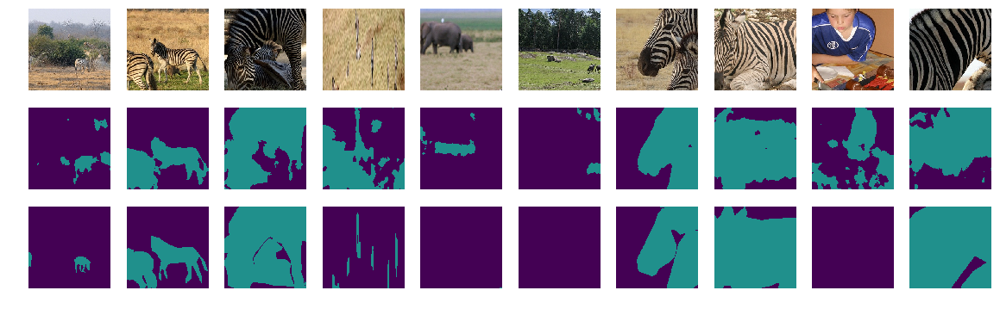

Loss on epoch 80 was: 0.08351807
Test accuracy after epoch 80 was: 0.83301180 +/- 0.13200177
Starting Epoch # 82
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


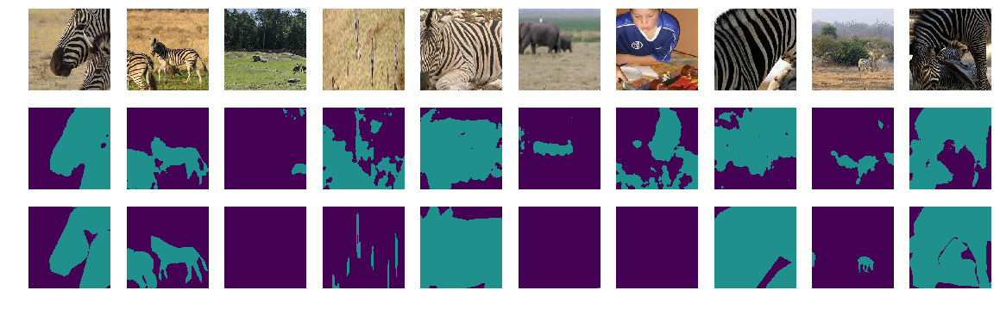

Loss on epoch 81 was: 0.01358289
Test accuracy after epoch 81 was: 0.82016701 +/- 0.14294910
Starting Epoch # 83
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


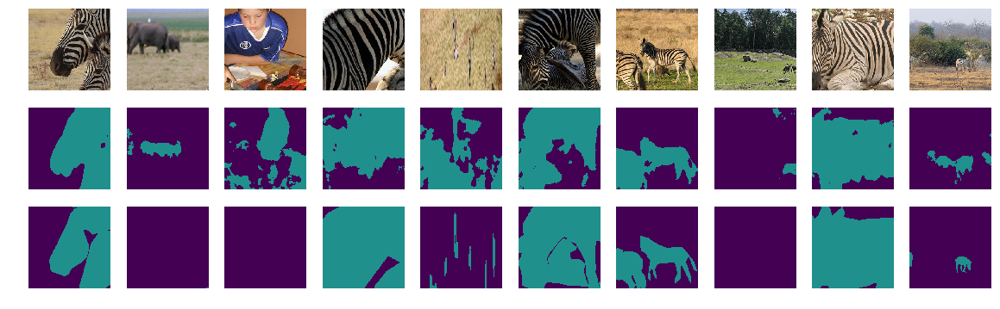

Loss on epoch 82 was: 0.01880192
Test accuracy after epoch 82 was: 0.82626953 +/- 0.13994709
Starting Epoch # 84
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


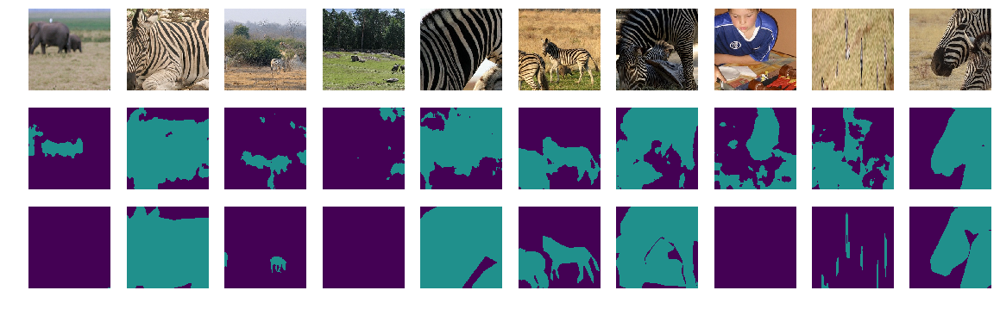

Loss on epoch 83 was: 0.02596055
Test accuracy after epoch 83 was: 0.81604552 +/- 0.13423868
Starting Epoch # 85
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


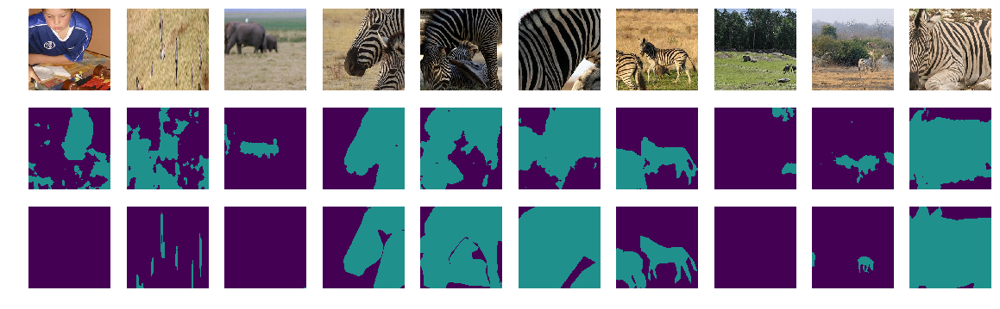

Loss on epoch 84 was: 0.02420889
Test accuracy after epoch 84 was: 0.82979512 +/- 0.12869943
Starting Epoch # 86
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


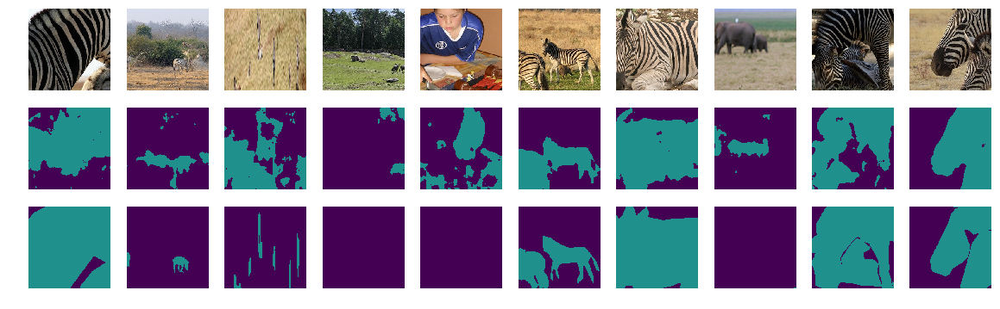

Loss on epoch 85 was: 0.03000633
Test accuracy after epoch 85 was: 0.81753627 +/- 0.12999436
Starting Epoch # 87
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


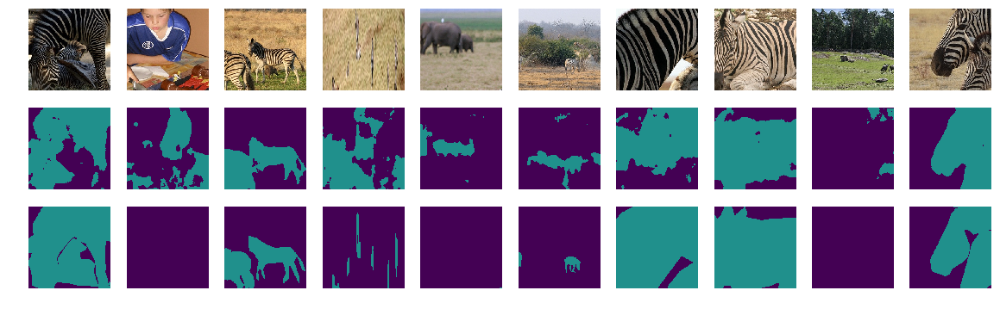

Loss on epoch 86 was: 0.02269200
Test accuracy after epoch 86 was: 0.81915258 +/- 0.13110663
Starting Epoch # 88
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


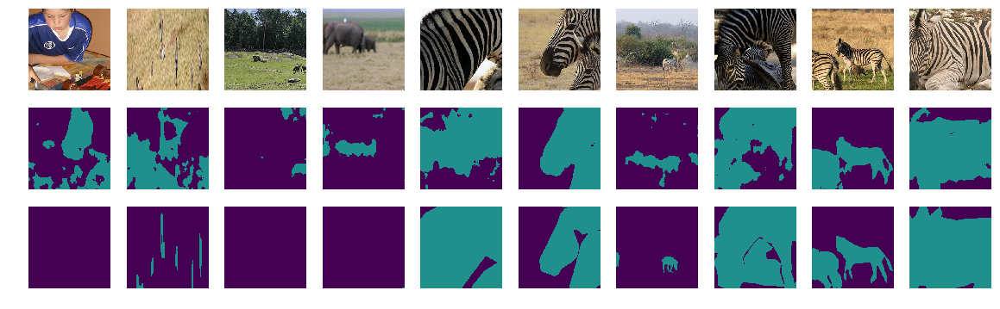

Loss on epoch 87 was: 0.02055272
Test accuracy after epoch 87 was: 0.82251076 +/- 0.13014369
Starting Epoch # 89
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


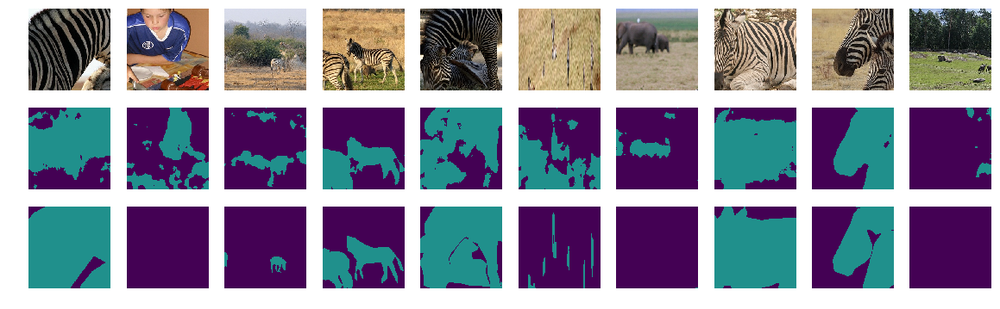

Loss on epoch 88 was: 0.01352155
Test accuracy after epoch 88 was: 0.82116350 +/- 0.12360444
Starting Epoch # 90
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


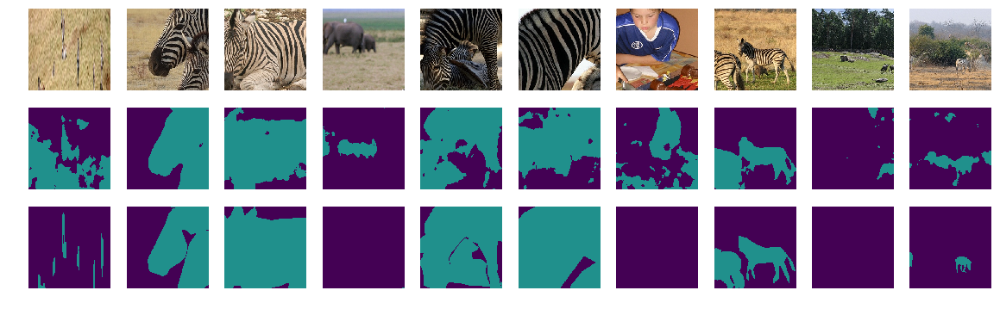

Loss on epoch 89 was: 0.01931968
Test accuracy after epoch 89 was: 0.82817482 +/- 0.12464117
Starting Epoch # 91
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


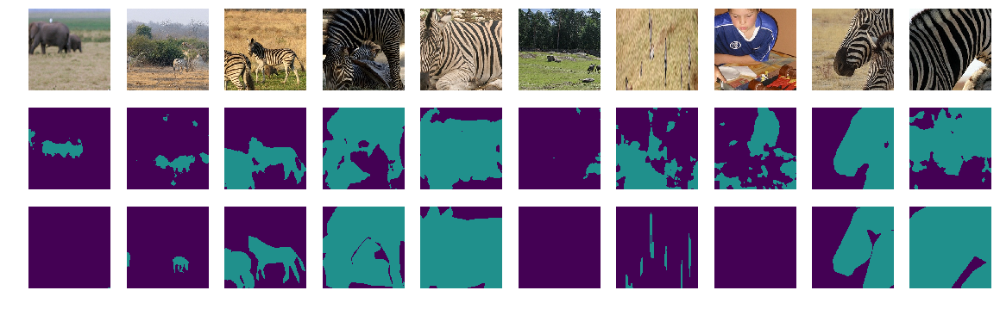

Loss on epoch 90 was: 0.02339542
Test accuracy after epoch 90 was: 0.83699976 +/- 0.12136001
Starting Epoch # 92
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


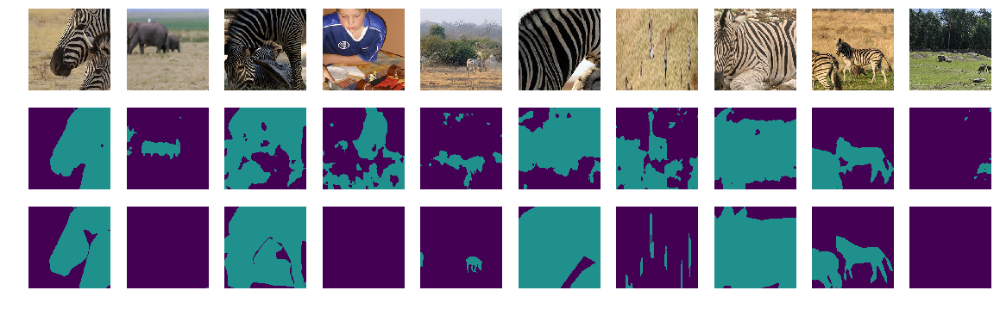

Loss on epoch 91 was: 0.02467587
Test accuracy after epoch 91 was: 0.82511161 +/- 0.13711752
Starting Epoch # 93
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


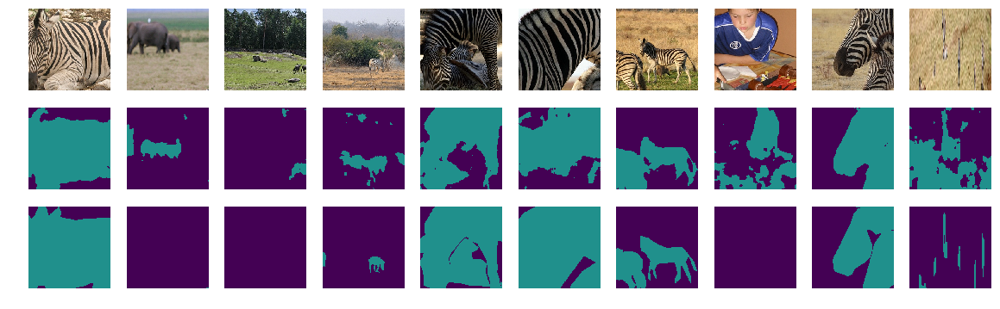

Loss on epoch 92 was: 0.01594255
Test accuracy after epoch 92 was: 0.82798151 +/- 0.13057648
Starting Epoch # 94
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


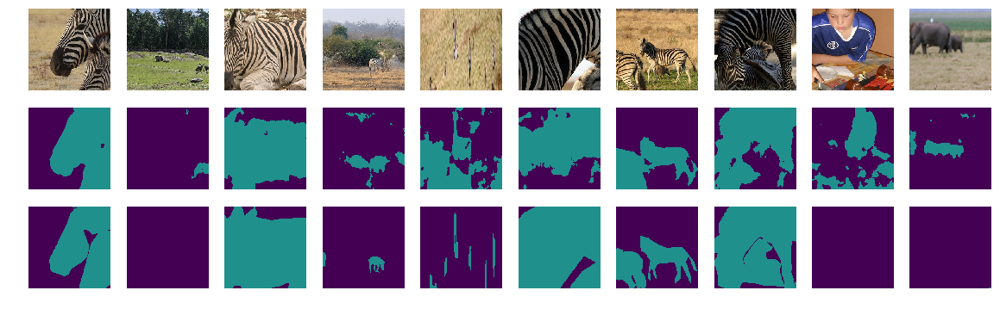

Loss on epoch 93 was: 0.02300258
Test accuracy after epoch 93 was: 0.83268694 +/- 0.12521442
Starting Epoch # 95
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


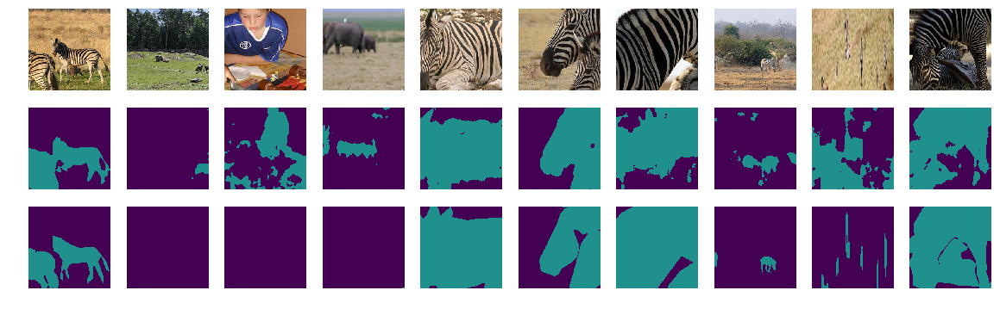

Loss on epoch 94 was: 0.02200745
Test accuracy after epoch 94 was: 0.83558076 +/- 0.12391665
Starting Epoch # 96
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


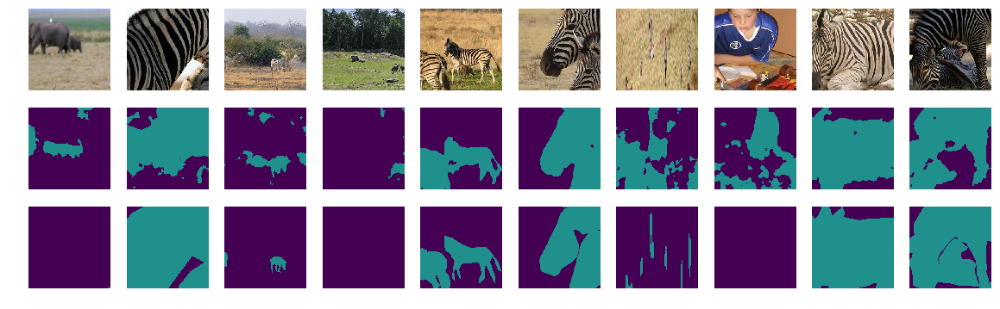

Loss on epoch 95 was: 0.01627867
Test accuracy after epoch 95 was: 0.82871492 +/- 0.12722866
Starting Epoch # 97
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


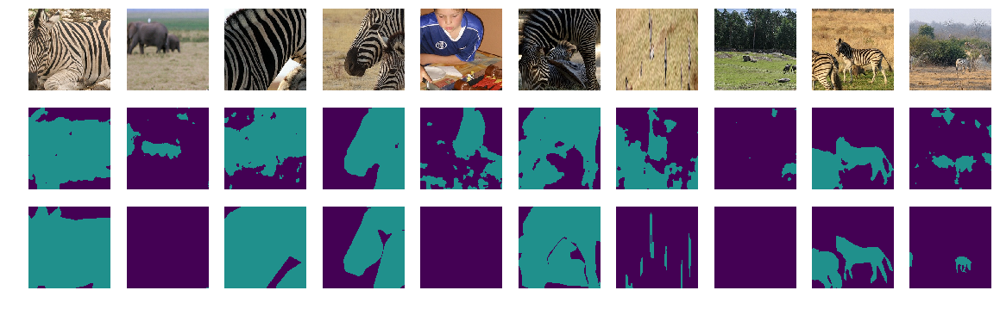

Loss on epoch 96 was: 0.02550488
Test accuracy after epoch 96 was: 0.82727997 +/- 0.12754347
Starting Epoch # 98
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


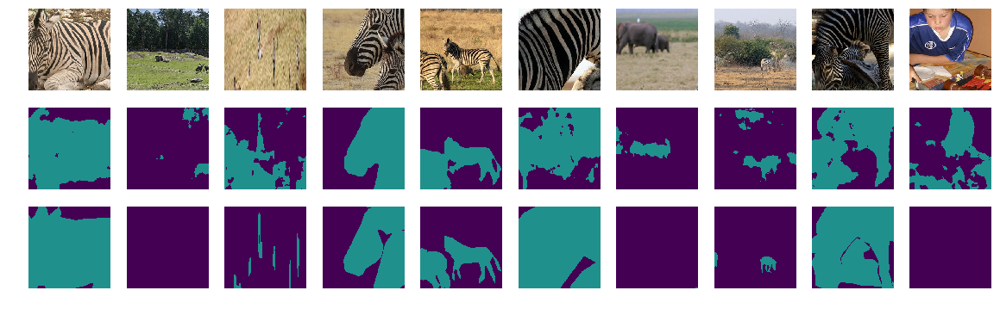

Loss on epoch 97 was: 0.03486473
Test accuracy after epoch 97 was: 0.82841996 +/- 0.12288550
Starting Epoch # 99
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


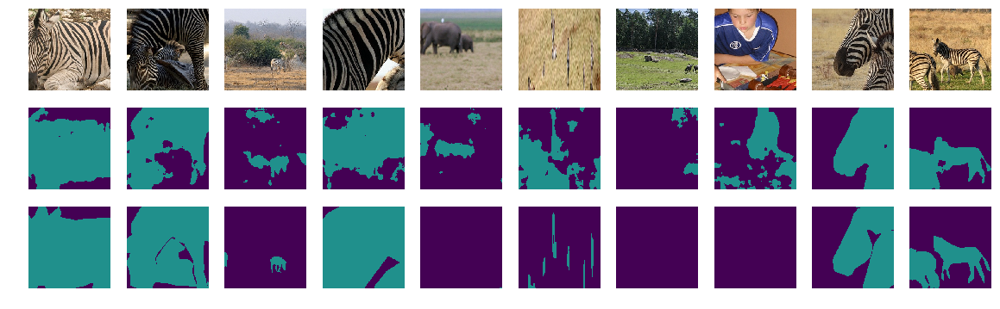

Loss on epoch 98 was: 0.02227294
Test accuracy after epoch 98 was: 0.82763871 +/- 0.11393230
Starting Epoch # 100
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


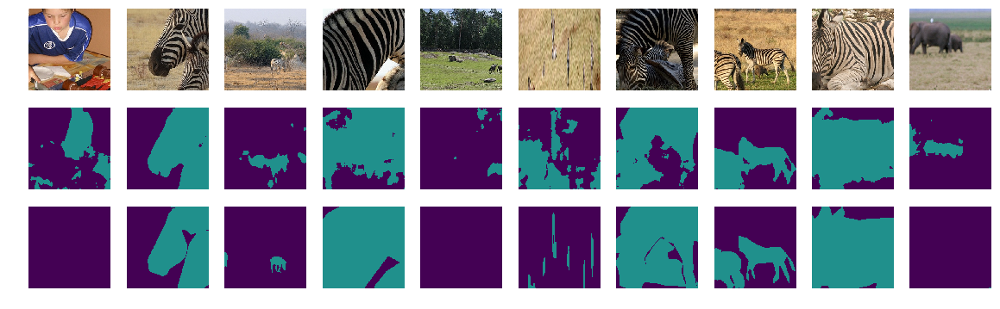

Loss on epoch 99 was: 0.02639019
Test accuracy after epoch 99 was: 0.84743901 +/- 0.10489998
Starting Epoch # 101
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


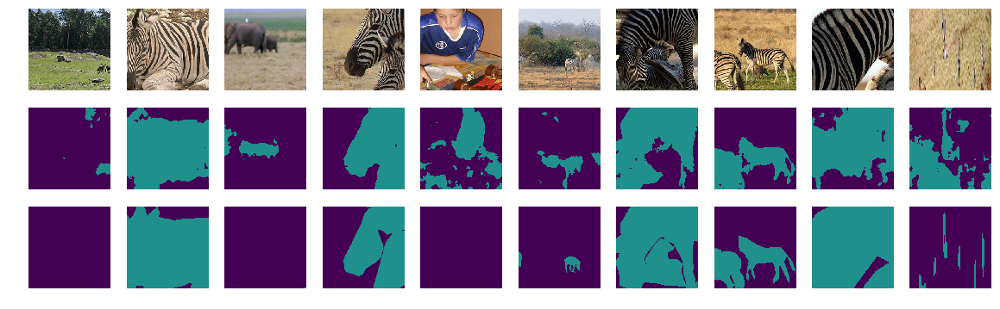

Loss on epoch 100 was: 0.01890833
Test accuracy after epoch 100 was: 0.84319794 +/- 0.11320731
Starting Epoch # 102
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


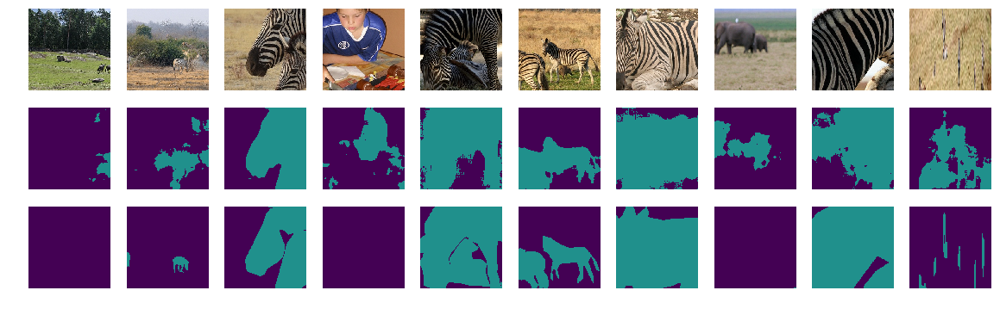

Loss on epoch 101 was: 0.05345675
Test accuracy after epoch 101 was: 0.83436105 +/- 0.09936637
Starting Epoch # 103
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


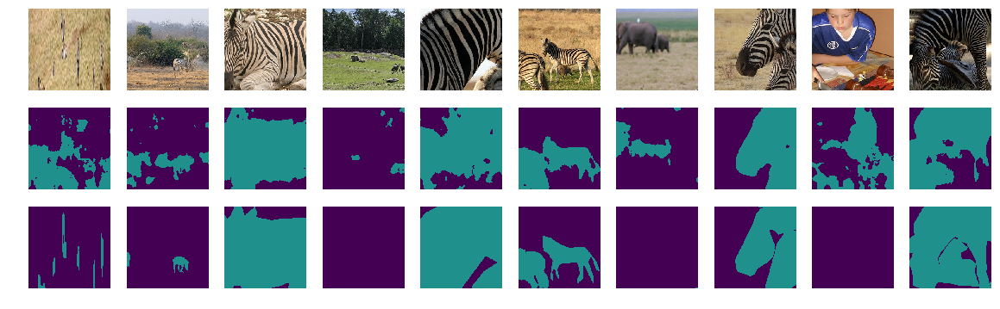

Loss on epoch 102 was: 0.03651675
Test accuracy after epoch 102 was: 0.82237524 +/- 0.12495507
Starting Epoch # 104
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


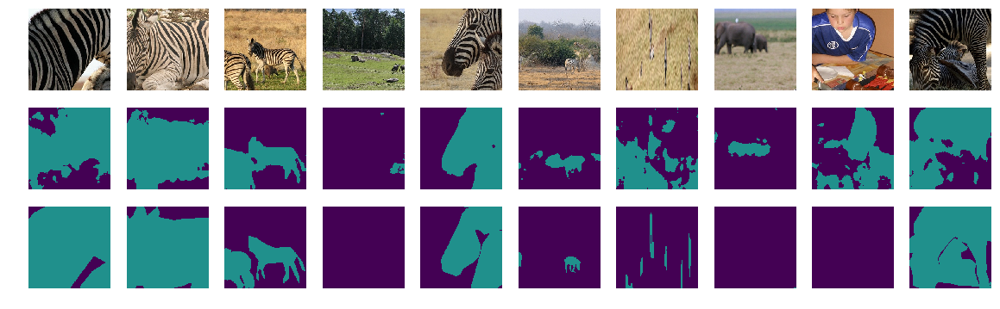

Loss on epoch 103 was: 0.02685728
Test accuracy after epoch 103 was: 0.82876873 +/- 0.13978964
Starting Epoch # 105
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


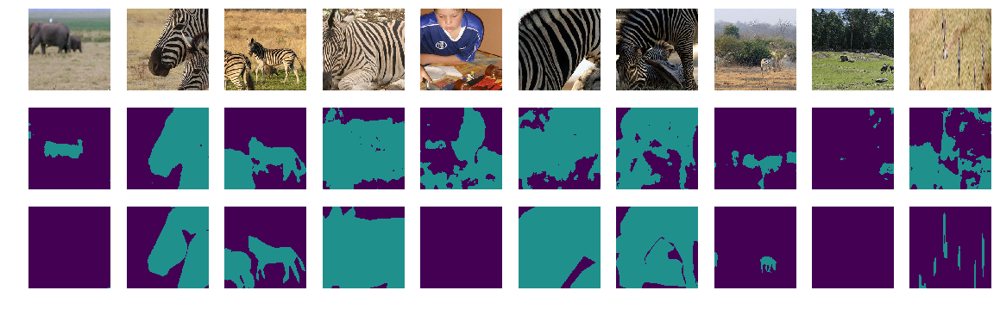

Loss on epoch 104 was: 0.02735898
Test accuracy after epoch 104 was: 0.82505381 +/- 0.14985940
Starting Epoch # 106
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


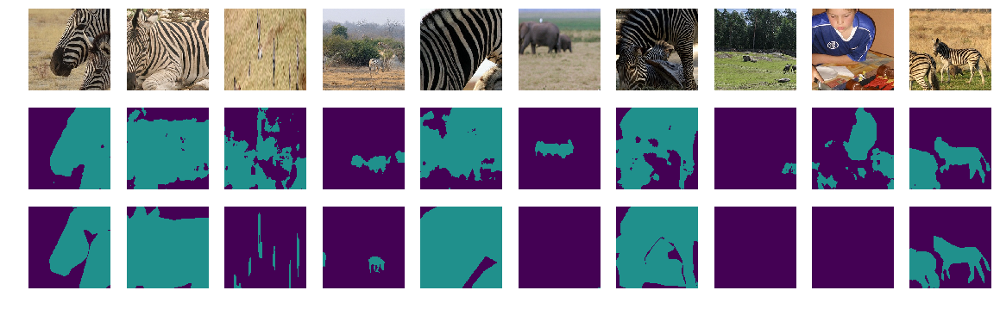

Loss on epoch 105 was: 0.03147701
Test accuracy after epoch 105 was: 0.84538823 +/- 0.12847179
Starting Epoch # 107
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


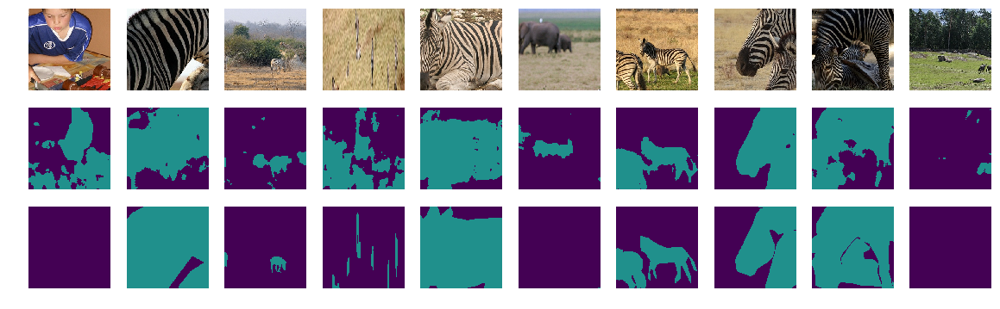

Loss on epoch 106 was: 0.01946719
Test accuracy after epoch 106 was: 0.82399952 +/- 0.14581342
Starting Epoch # 108
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


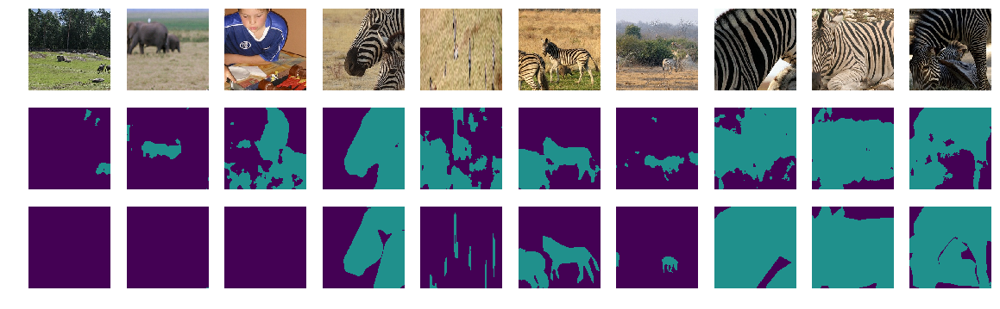

Loss on epoch 107 was: 0.01532372
Test accuracy after epoch 107 was: 0.82686942 +/- 0.14543093
Starting Epoch # 109
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


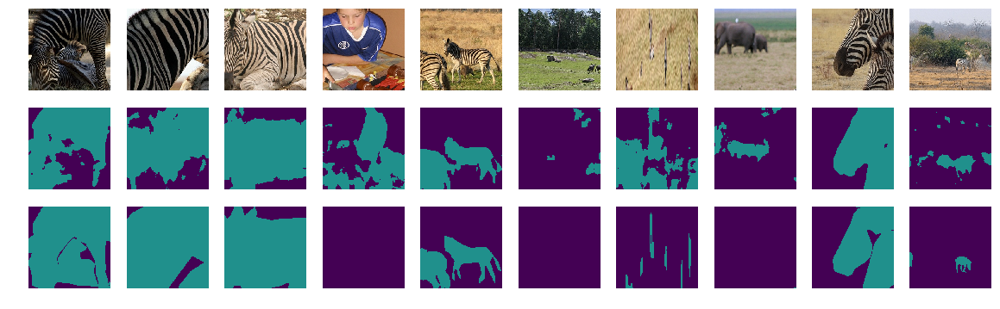

Loss on epoch 108 was: 0.02708183
Test accuracy after epoch 108 was: 0.81981625 +/- 0.14150927
Starting Epoch # 110
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


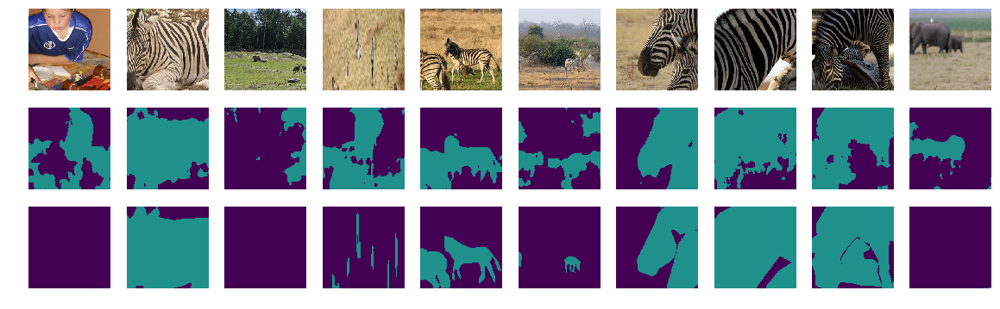

Loss on epoch 109 was: 0.04631775
Test accuracy after epoch 109 was: 0.77958586 +/- 0.13566767
Starting Epoch # 111
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


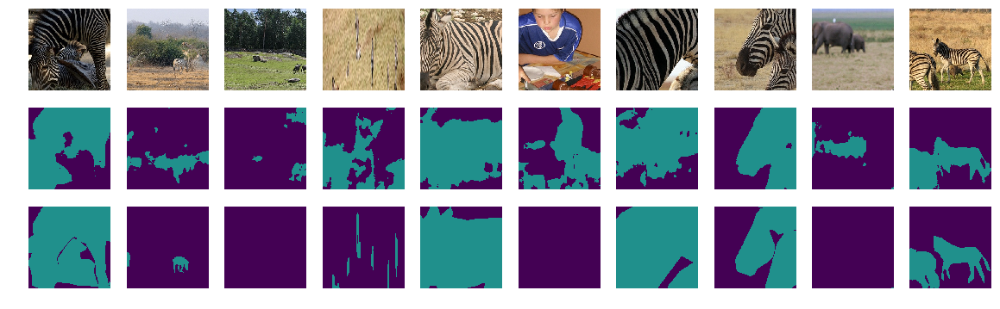

Loss on epoch 110 was: 0.03060107
Test accuracy after epoch 110 was: 0.81465043 +/- 0.12590312
Starting Epoch # 112
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


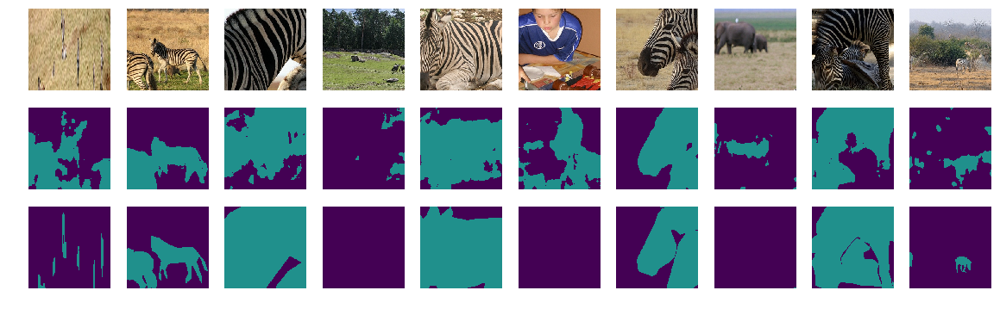

Loss on epoch 111 was: 0.01921766
Test accuracy after epoch 111 was: 0.81282286 +/- 0.13237621
Starting Epoch # 113
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


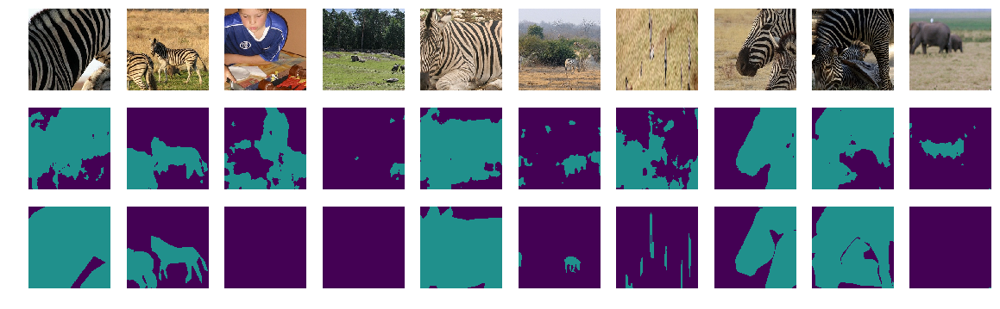

Loss on epoch 112 was: 0.02703124
Test accuracy after epoch 112 was: 0.82324418 +/- 0.14601761
Starting Epoch # 114
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


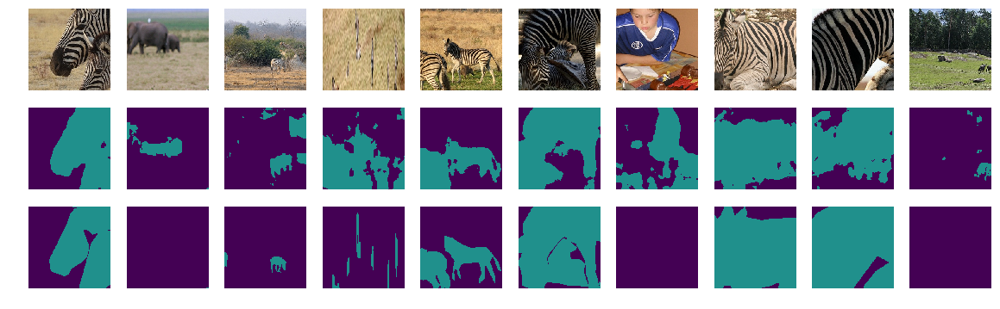

Loss on epoch 113 was: 0.02763256
Test accuracy after epoch 113 was: 0.81348453 +/- 0.14360325
Starting Epoch # 115
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


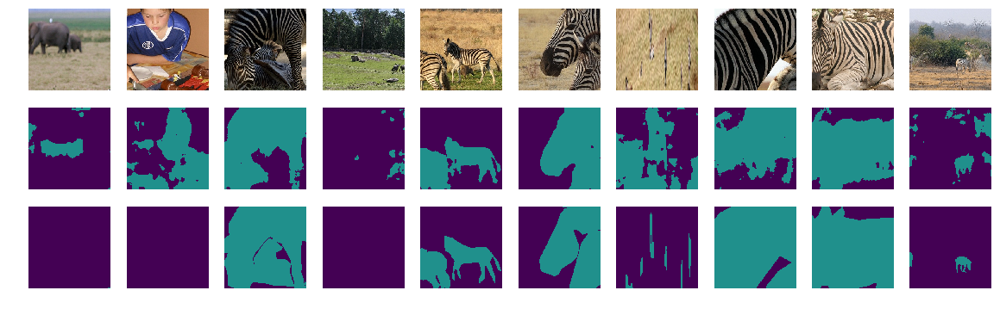

Loss on epoch 114 was: 0.03118913
Test accuracy after epoch 114 was: 0.81173868 +/- 0.15552966
Starting Epoch # 116
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


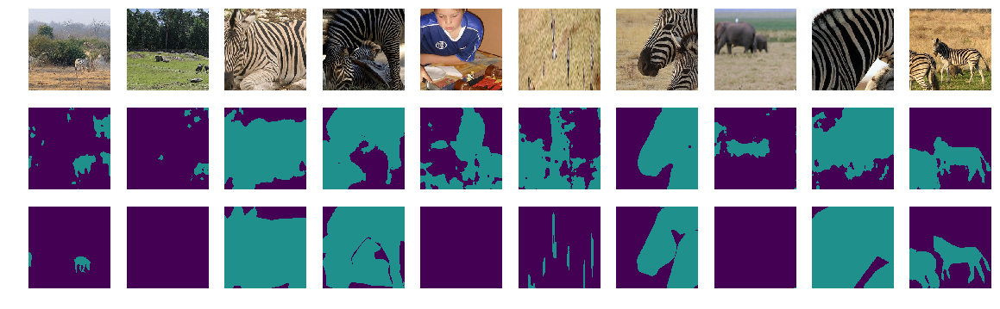

Loss on epoch 115 was: 0.01806757
Test accuracy after epoch 115 was: 0.80723653 +/- 0.15393333
Starting Epoch # 117
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


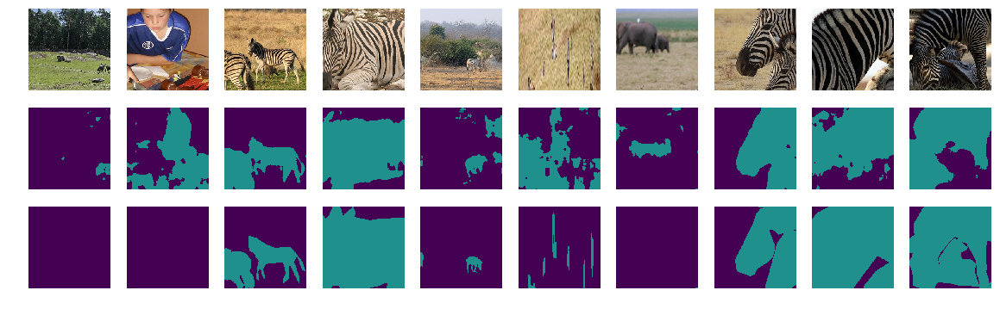

Loss on epoch 116 was: 0.01069268
Test accuracy after epoch 116 was: 0.81882773 +/- 0.14455105
Starting Epoch # 118
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


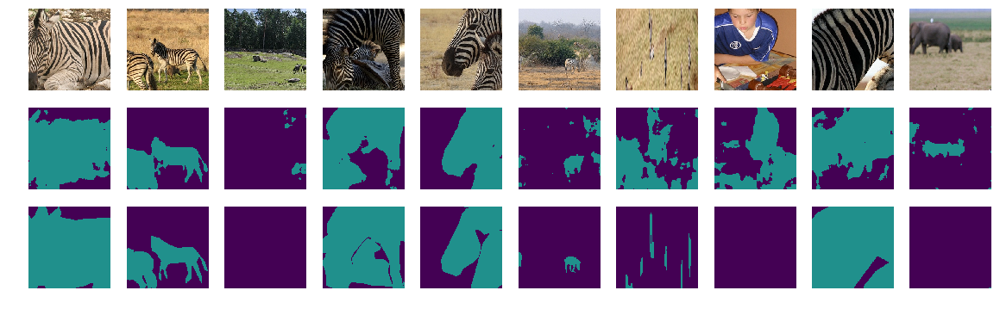

Loss on epoch 117 was: 0.02451021
Test accuracy after epoch 117 was: 0.81991789 +/- 0.14634082
Starting Epoch # 119
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


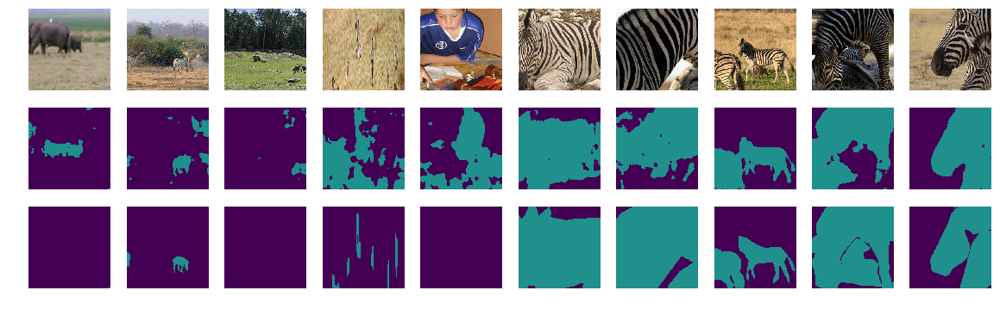

Loss on epoch 118 was: 0.02306735
Test accuracy after epoch 118 was: 0.82054169 +/- 0.14348167
Starting Epoch # 120
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


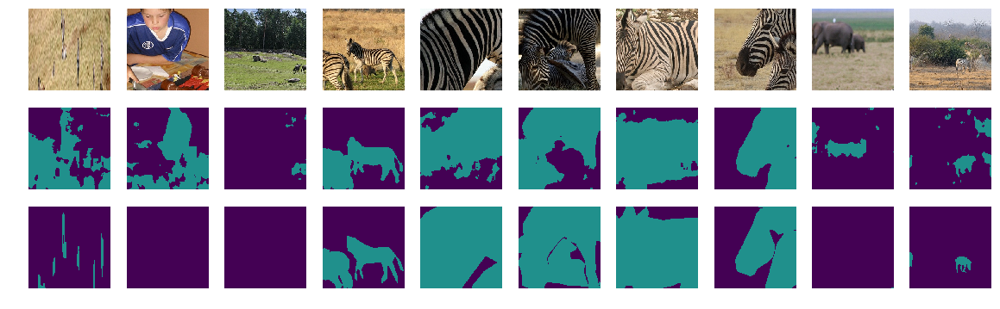

Loss on epoch 119 was: 0.01439315
Test accuracy after epoch 119 was: 0.81706792 +/- 0.14718667
Starting Epoch # 121
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


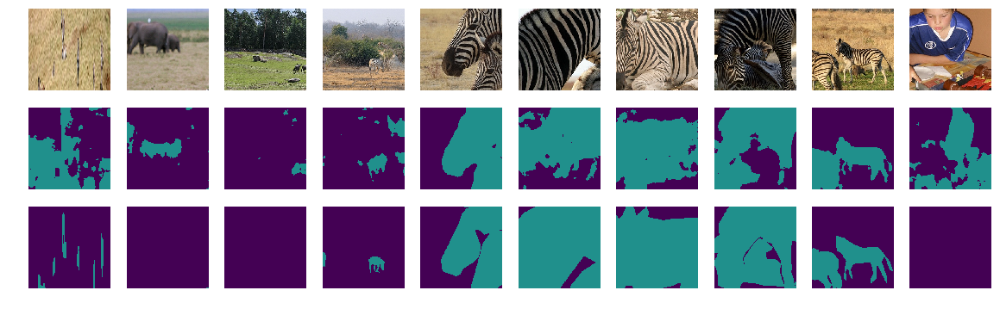

Loss on epoch 120 was: 0.02067477
Test accuracy after epoch 120 was: 0.81508291 +/- 0.14485341
Starting Epoch # 122
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


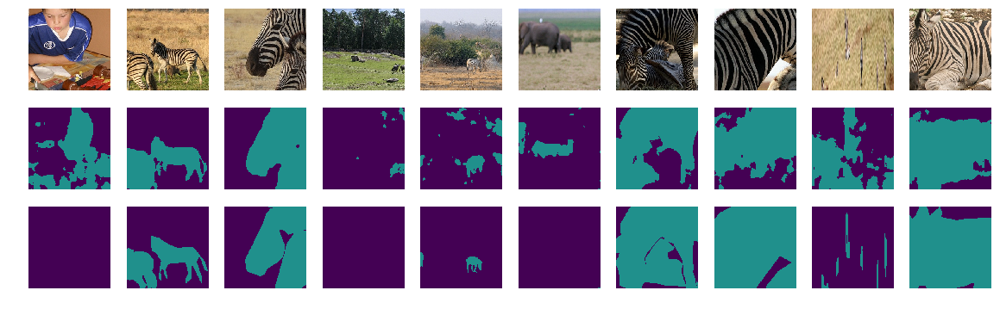

Loss on epoch 121 was: 0.02180983
Test accuracy after epoch 121 was: 0.81887556 +/- 0.13890007
Starting Epoch # 123
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


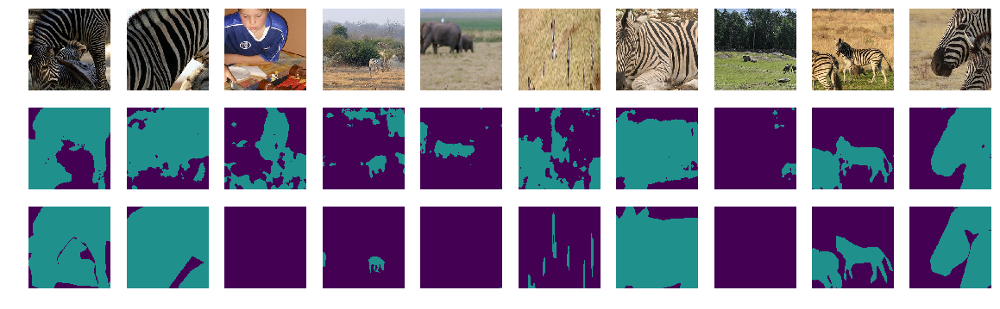

Loss on epoch 122 was: 0.01610928
Test accuracy after epoch 122 was: 0.82427655 +/- 0.12484542
Starting Epoch # 124
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


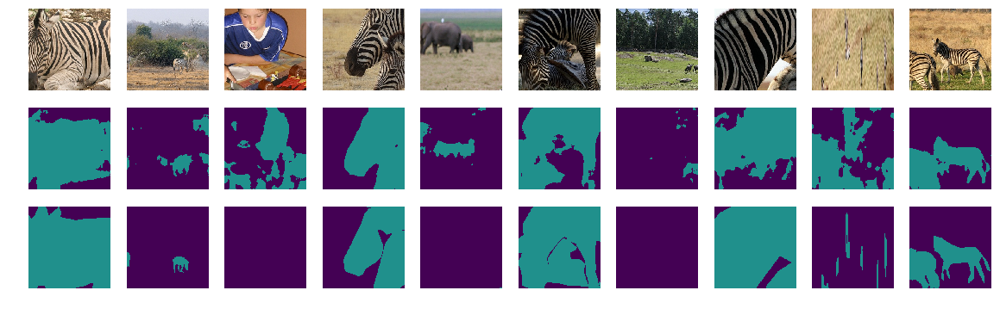

Loss on epoch 123 was: 0.03774180
Test accuracy after epoch 123 was: 0.82207031 +/- 0.14265452
Starting Epoch # 125
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


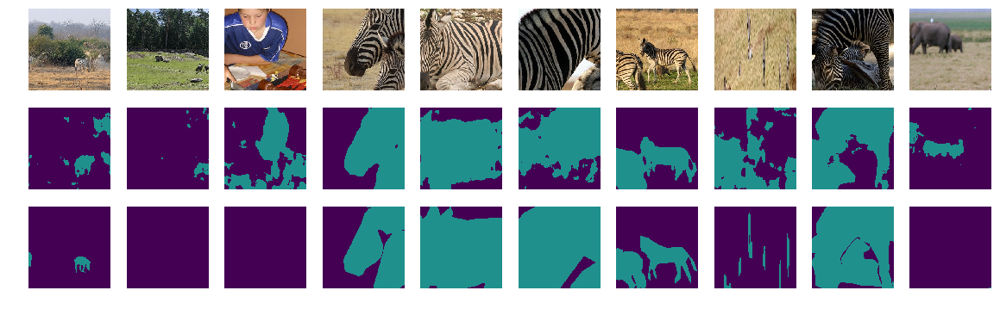

Loss on epoch 124 was: 0.01167007
Test accuracy after epoch 124 was: 0.82277782 +/- 0.13438827
Starting Epoch # 126
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


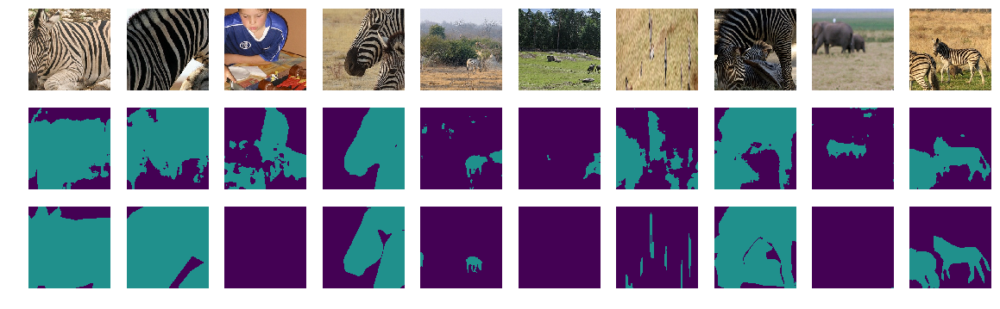

Loss on epoch 125 was: 0.01568904
Test accuracy after epoch 125 was: 0.83852639 +/- 0.12656914
Starting Epoch # 127
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
testing results


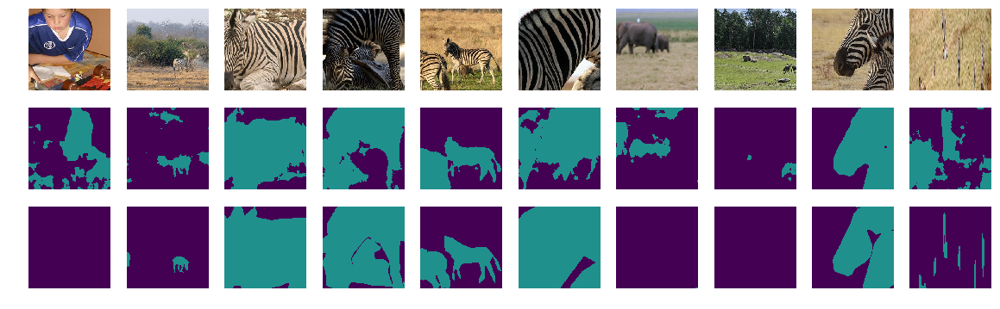

Loss on epoch 126 was: 0.01422231
Test accuracy after epoch 126 was: 0.82754106 +/- 0.11598082
Starting Epoch # 128


Process Process-2116:
Process Process-2115:
Process Process-2113:
Process Process-2117:
Traceback (most recent call last):
Process Process-2119:
Traceback (most recent call last):
Traceback (most recent call last):
Process Process-2114:
Process Process-2120:
Traceback (most recent call last):
  File "/home/jeff/anaconda2/envs/pytorch_2/lib/python2.7/multiprocessing/process.py", line 267, in _bootstrap
Process Process-2118:
  File "/home/jeff/anaconda2/envs/pytorch_2/lib/python2.7/multiprocessing/process.py", line 267, in _bootstrap
  File "/home/jeff/anaconda2/envs/pytorch_2/lib/python2.7/multiprocessing/process.py", line 267, in _bootstrap
Traceback (most recent call last):
Traceback (most recent call last):
  File "/home/jeff/anaconda2/envs/pytorch_2/lib/python2.7/multiprocessing/process.py", line 267, in _bootstrap
Traceback (most recent call last):
Traceback (most recent call last):
  File "/home/jeff/anaconda2/envs/pytorch_2/lib/python2.7/multiprocessing/process.py", line 267, in 

KeyboardInterrupt: 

In [66]:
# generate weigth tensor for loss function 
device = 'cuda'
weight_tensor = torch.ones(len(my_segnet.object_label_dict)).to(device)
for key,value in my_segnet.object_label_dict.items():
    weight_tensor[value] = weight_dict[key]   

my_segnet.define_loss_function(loss_fun = nn.CrossEntropyLoss,
                               weight = weight_tensor)

my_segnet.train(num_epochs = 300)

In [ ]:
# best_model_wts = copy.deepcopy(model.state_dict())
# best_acc = 0.0

# # load best model weights
# model.load_state_dict(best_model_wts)
# return model